# Figures preparation

In [1]:
import scanpy as sc
import seaborn as sns
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import scvelo as scv
import scanpy.external as sce
import anndata as ad
from tqdm.notebook import tqdm
import copy

PROJECT_DIR = "/home/sisaev/projects/Gustafsson_et_al_2022"
DATA_DIR = "/home/sisaev/data/thymus_Karin/count"
exec(open(f"{PROJECT_DIR}/tools/tools.py").read())

sc.settings.verbosity = 3
sns.set(font_scale=1)
sc.settings.set_figure_params(dpi=150, dpi_save=500)
sns.set_style("white")

Reds = get_beautiful_cmap()

paper_cmap_mouse = {
    "EC" : "#71fdea",
    "TEC A" : "#1d25f3",
    "TEC B" : "#dcae3d",
    "pcPV" : "#ae0b09",
    "aPV" : "#fda936",
    "Tuft cells" : "#a1fb73",
    "Lrrn4+" : "#f443a9",
    "MC" : "#6b04d4",
    "NC" : "#34be1e",
    "HC" : "#ff0000",
    "SM" : "#00573e",
    "Penk+ Cdh11+ MC" : "#00b3f4",
    "Cd248+ MC" : "#008af6",
    "Postn+ MC" : "#ed00ff"
}

paper_cmap_human = {
    "aEC" : "#06c1cc",
    "lyEC" : "#10d4ae",
    "pcEC" : "#71fdea",
    "pcPV" : "#ae0b09",
    "aPV" : "#fda936",
    "MC" : "#6e4aae",
    "HC" : "#ff0000",
    "cTEC" : "#0912ff",
    "mTECimm" : "#050bab",
    "mTECmn" : "#2751ab",
    "CDH11+ MC" : "#00b3f4",
    "CD248+ MC" : "#008af6",
    "POSTN+ MC" : "#ed00ff",
    "CDH11+ MC (stress)" : "#00573e",
    "Cycling MC" : "#00573e"
}

## Figure 1

### Figure 1B

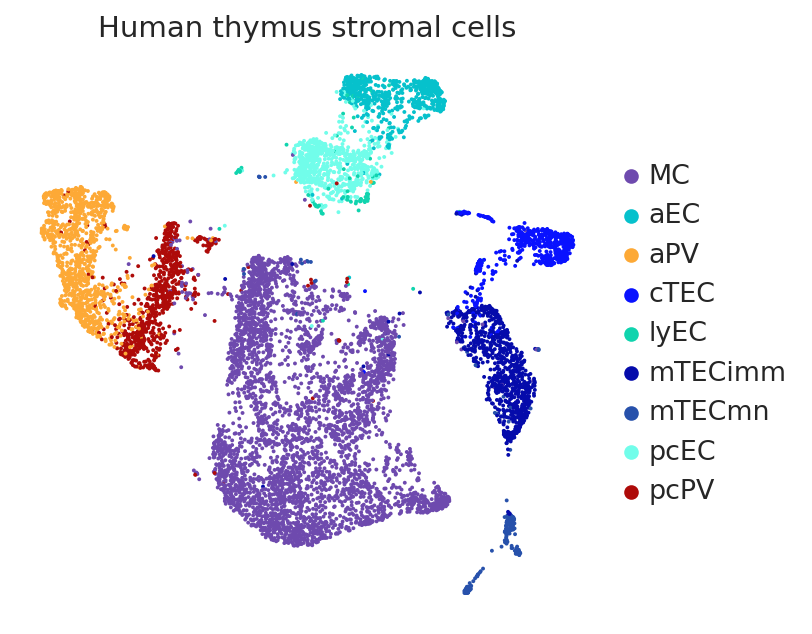

In [2]:
adata_human_SC = sc.read_h5ad(f"{PROJECT_DIR}/data/Human_SC_conos.h5ad")
adata_human_SC.uns["cell_type_colors"] = [paper_cmap_human[ct] for ct in adata_human_SC.obs.cell_type.cat.categories]
fig, ax = plt.subplots(figsize=(5, 5))
sc.pl.umap(adata_human_SC, color="cell_type", frameon=False, ax=ax, show=False, title="Human thymus stromal cells")
plt.savefig(f"{PROJECT_DIR}/figures/Fig1B.pdf", bbox_inches="tight")
del adata_human_SC

### Figure 1C

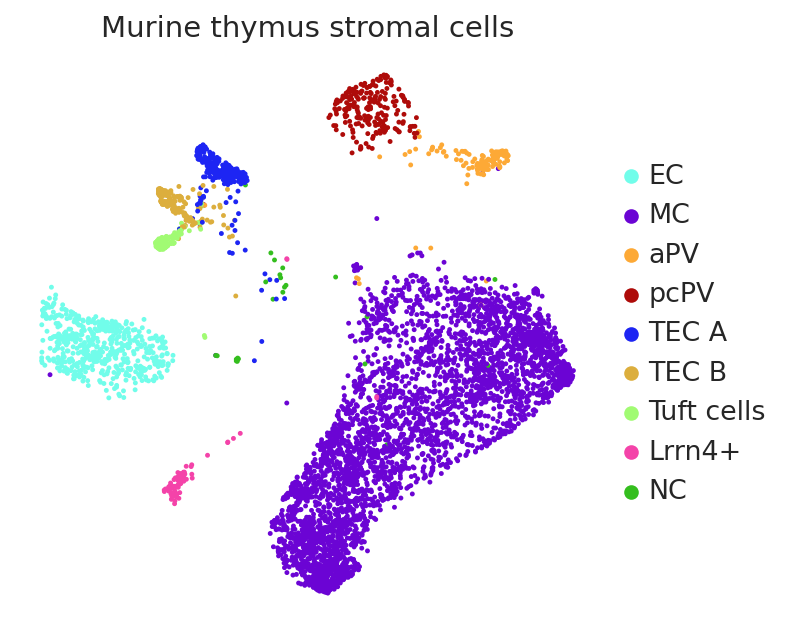

In [3]:
adata_mouse_SC = sc.read_h5ad(f"{PROJECT_DIR}/data/Mouse_SC_conos.h5ad")
adata_mouse_SC.uns["cell_type_colors"] = [paper_cmap_mouse[ct] for ct in adata_mouse_SC.obs.cell_type.cat.categories]
fig, ax = plt.subplots(figsize=(5, 5))
sc.pl.umap(adata_mouse_SC[adata_mouse_SC.obs.condition == "control"], color="cell_type", frameon=False, ax=ax, show=False, title="Murine thymus stromal cells")
plt.savefig(f"{PROJECT_DIR}/figures/Fig1C.pdf", bbox_inches="tight")
del adata_mouse_SC

### Figure 1D

In [4]:
adata_human_SC = sc.read_h5ad(f"{PROJECT_DIR}/data/Human_SC_conos.h5ad")
get_cluster_sizes(adata_human_SC, cluster_key="cell_type", sample_key="sample_id").to_csv(f"{PROJECT_DIR}/figures/Fig1D.tsv", sep="\t")
del adata_human_SC

### Figure 1F

In [5]:
adata_mouse_SC = sc.read_h5ad(f"{PROJECT_DIR}/data/Mouse_SC_conos.h5ad")
get_cluster_sizes(adata_mouse_SC[adata_mouse_SC.obs.condition == "control"], cluster_key="cell_type", sample_key="sample_id").to_csv(f"{PROJECT_DIR}/figures/Fig1F.tsv", sep="\t")
del adata_mouse_SC

### Figure 1H

In [6]:
adata_human_SC = sc.read_h5ad(f"{PROJECT_DIR}/data/Human_SC_conos.h5ad")
genes_to_color_human = ["FLT3LG", "BMP4", "CXCL12", "DLL4", "CCL25", "IL15", "IL7", "CCL21", "CCL19", "BMP2", "KITLG"]

adata_human_SC.obs.cell_type = adata_human_SC.obs.cell_type.cat.reorder_categories(
    ["pcEC", "aEC", "lyEC", "MC", "cTEC", "mTECimm", "mTECmn", "pcPV", "aPV"]
)

pd.DataFrame(adata_human_SC.obs["cell_type"]).to_csv(f"{PROJECT_DIR}/data/Human_MS_pagoda2_conos/cell_types.csv")

In [7]:
%load_ext rpy2.ipython

In [8]:
%%R
library(conos)
library(pagoda2)

R[write to console]: Loading required package: Matrix

R[write to console]: Loading required package: igraph

R[write to console]: 
Attaching package: ‘igraph’


R[write to console]: The following objects are masked from ‘package:stats’:

    decompose, spectrum


R[write to console]: The following object is masked from ‘package:base’:

    union


R[write to console]: 
Attaching package: ‘pagoda2’


R[write to console]: The following objects are masked from ‘package:conos’:

    buildWijMatrix, projectKNNs, sgdBatches




In [9]:
%%R
con <- readRDS("/home/sisaev/projects/Gustafsson_et_al_2022/data/Human_MS_pagoda2_conos/conos.rds")
celltype <- read.table("/home/sisaev/projects/Gustafsson_et_al_2022/data/Human_MS_pagoda2_conos/cell_types.csv", sep = ",", header = 1, row.names = 1)
celltype <- setNames(celltype$cell_type, rownames(celltype))
r <- convertToPagoda2(con)

R[write to console]: 8628 cells, 36601 genes; normalizing ... 

R[write to console]: Using plain model 

R[write to console]: log scale ... 

R[write to console]: done.


R[write to console]: Estimating PCA... 

R[write to console]: Done




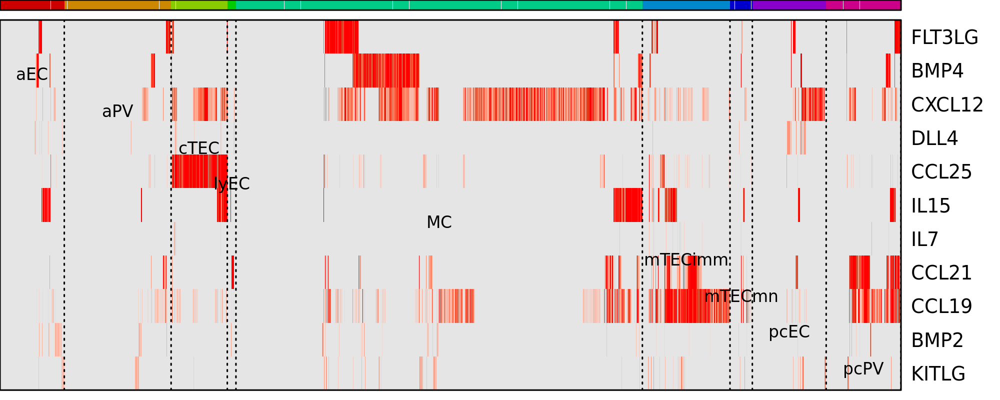

In [10]:
%%R -w 2000 -r 300 -h 800
gene.list <- as.vector(c("FLT3LG", "BMP4", "CXCL12", "DLL4", "CCL25", "IL15", "IL7", "CCL21", "CCL19", "BMP2", "KITLG"))
r$plotGeneHeatmap(
    genes = gene.list,
    groups = celltype,
    inner.clustering = TRUE,
    drawGroupNames = TRUE
)

### Figure 1I

In [11]:
adata_mouse_SC = sc.read_h5ad(f"{PROJECT_DIR}/data/Mouse_SC_conos.h5ad")
pd.DataFrame(adata_mouse_SC[adata_mouse_SC.obs.condition == "control"].obs["cell_type"]).to_csv(f"{PROJECT_DIR}/data/Mouse_SC_pagoda2_conos/cell_types.csv")
genes_to_color_mouse = ["Flt3l", "Bmp4", "Cxl12", "Dll4", "Ccl25", "Il15", "Il7", "Ccl21a", "Ccl19", "Bmp2", "Kitl"]

In [ ]:
%load_ext rpy2.ipython

In [20]:
%%R
library(conos)
library(pagoda2)

In [12]:
%%R
con <- readRDS("/home/sisaev/projects/Gustafsson_et_al_2022/data/Mouse_SC_pagoda2_conos/conos.rds")
celltype <- read.table("/home/sisaev/projects/Gustafsson_et_al_2022/data/Mouse_SC_pagoda2_conos/cell_types.csv", sep = ",", header = 1, row.names = 1)
celltype <- setNames(celltype$cell_type, rownames(celltype))
r <- convertToPagoda2(con)

R[write to console]: 34237 cells, 32285 genes; normalizing ... 

R[write to console]: Using plain model 

R[write to console]: log scale ... 

R[write to console]: done.


R[write to console]: Estimating PCA... 

R[write to console]: Done




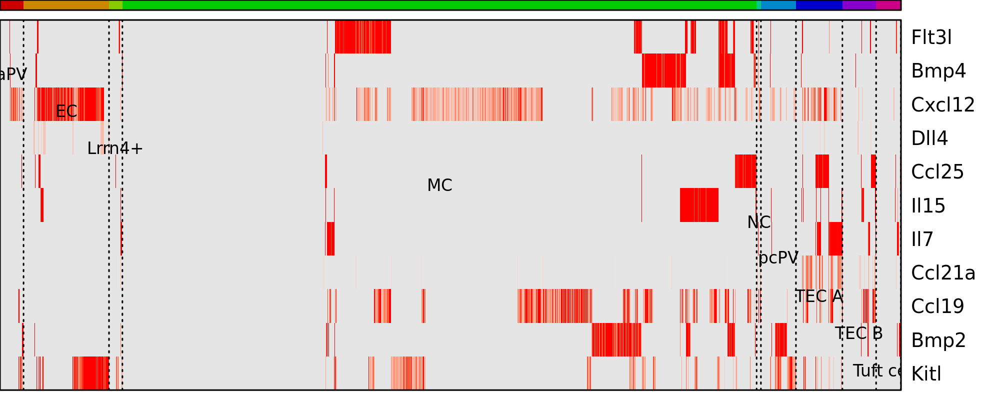

In [14]:
%%R -w 2000 -r 300 -h 800
gene.list <- as.vector(c("Flt3l", "Bmp4", "Cxcl12", "Dll4", "Ccl25", "Il15", "Il7", "Ccl21a", "Ccl19", "Bmp2", "Kitl"))
r$plotGeneHeatmap(
    genes = gene.list,
    groups = celltype,
    inner.clustering = TRUE,
    drawGroupNames = TRUE
)

### Figures with markers

... as `zero_center=True`, sparse input is densified and may lead to large memory consumption


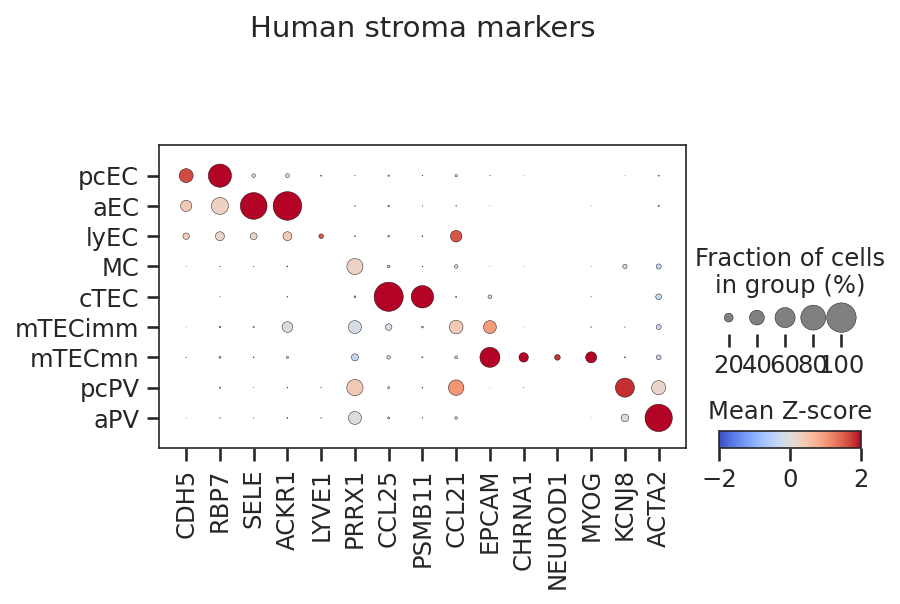

In [15]:
sns.set_style("ticks")

adata_human_SC = sc.read_h5ad(f"{PROJECT_DIR}/data/Human_SC_conos.h5ad")
adata_human_SC.layers["z-score"] = adata_human_SC.X.copy()
sc.pp.scale(adata_human_SC, layer="z-score")

adata_human_SC.obs.cell_type = adata_human_SC.obs.cell_type.cat.reorder_categories(
    ["pcEC", "aEC", "lyEC", "MC", "cTEC", "mTECimm", "mTECmn", "pcPV", "aPV"]
)
markers = [
    "CDH5", "RBP7", #pcEC
    "SELE", "ACKR1", #aEC
    "LYVE1", #lyEC
    "PRRX1", #MC
    "CCL25", "PSMB11", #cTEC
    "CCL21", #mTECimm
    "EPCAM", "CHRNA1", "NEUROD1", "MYOG", #mTECmn
    "KCNJ8", #pcPV
    "ACTA2" #aPV
]

sns.set_style("ticks")
fig, ax = plt.subplots(figsize=(6, 3.5))
sc.pl.dotplot(adata_human_SC, var_names=markers, cmap="coolwarm", layer="z-score", groupby="cell_type", vmin=-2, vmax=2,
              colorbar_title="Mean Z-score", ax=ax, show=False, title="Human stroma markers")
plt.savefig(f"{PROJECT_DIR}/figures/Human_stroma_markers.pdf", bbox_inches="tight")
sns.set_style("white")

del markers, adata_human_SC

... as `zero_center=True`, sparse input is densified and may lead to large memory consumption
Trying to set attribute `.obs` of view, copying.


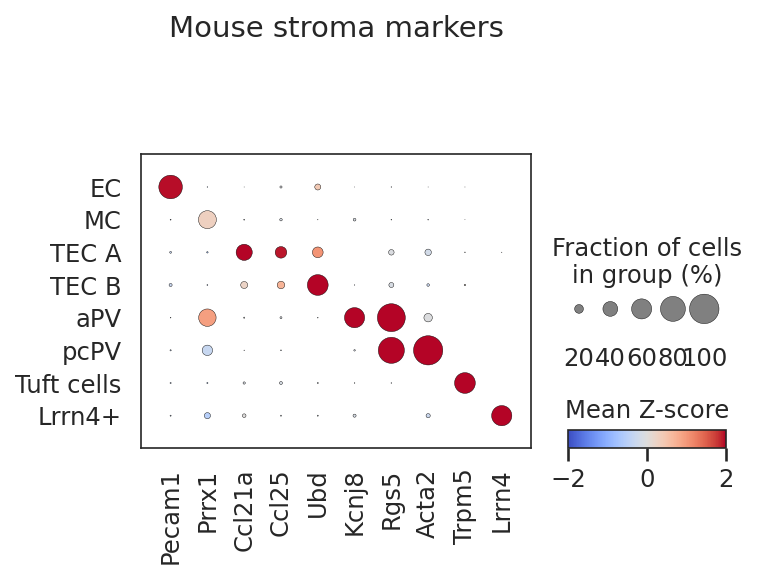

In [16]:
adata_mouse_SC = sc.read_h5ad(f"{PROJECT_DIR}/data/Mouse_SC_conos.h5ad")
adata_mouse_SC.layers["z-score"] = adata_mouse_SC.X.copy()
sc.pp.scale(adata_mouse_SC, layer="z-score")
adata_mouse_SC = adata_mouse_SC[adata_mouse_SC.obs.condition == "control"]

adata_mouse_SC.obs.cell_type = adata_mouse_SC.obs.cell_type.cat.reorder_categories([
    "EC", "MC", "TEC A", "TEC B", "aPV", "pcPV", "Tuft cells", "Lrrn4+", "NC"
])

markers = {
    "EC" : ["Pecam1"],
    "MC" : ["Prrx1"],
    "TEC A" : ["Ccl21a", "Ccl25"],
    "TEC B" : ["Ubd"],
    "aPV" : ["Kcnj8", "Rgs5"],
    "pcPV" : ["Acta2"],
    "Tuft cells" : ["Trpm5"],
    "Lrrn4+" : ["Lrrn4"]
}

fig, ax = plt.subplots(figsize=(5, 3.5))
sc.pl.dotplot(adata_mouse_SC[adata_mouse_SC.obs.cell_type != "NC"], var_names=sum(markers.values(), []), cmap="coolwarm", layer="z-score", groupby="cell_type", vmin=-2, vmax=2,
              colorbar_title="Mean Z-score", ax=ax, show=False, title="Mouse stroma markers")
plt.savefig(f"{PROJECT_DIR}/figures/Mouse_stroma_markers.pdf", bbox_inches="tight")

del markers, adata_mouse_SC

## Figure 2

### Figure 2A

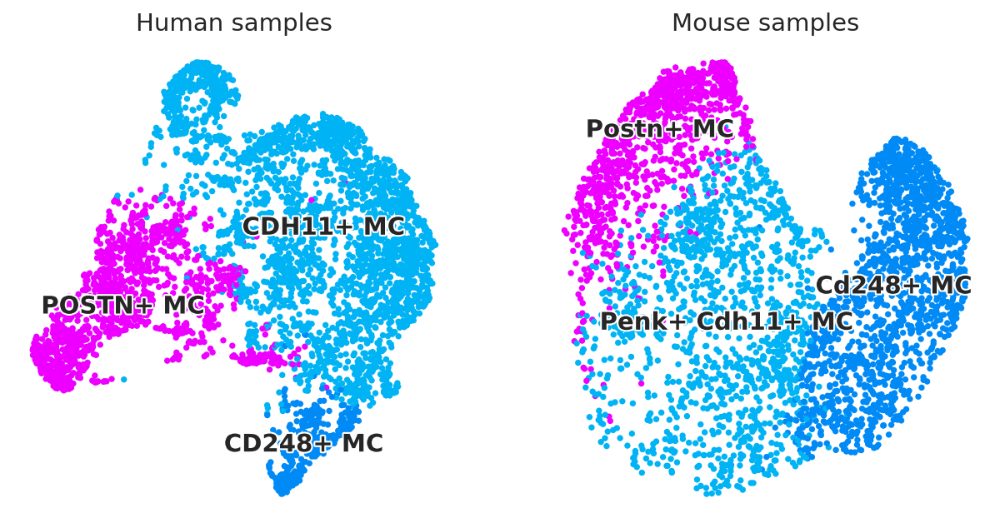

In [17]:
sns.set_style("white")

adata_mouse_MC = sc.read_h5ad(f"{PROJECT_DIR}/data/Mouse_MC_conos.h5ad")
adata_human_MC = sc.read_h5ad(f"{PROJECT_DIR}/data/Human_MC_conos.h5ad")
fig, axes = plt.subplots(figsize=(10, 5), ncols=2)
sc.pl.umap(adata_human_MC, color="cell_type_l2", frameon=False, ax=axes[0], show=False,
           title="Human samples", legend_loc="on data", legend_fontoutline=2, s=50)
sc.pl.umap(adata_mouse_MC[adata_mouse_MC.obs.condition == "control"], color="cell_type_l2", frameon=False, ax=axes[1], show=False,
           title="Mouse samples", legend_loc="on data", legend_fontoutline=2, s=50)
plt.savefig(f"{PROJECT_DIR}/figures/Fig2A.pdf", bbox_inches="tight")
del adata_mouse_MC, adata_human_MC

### Figure 2B

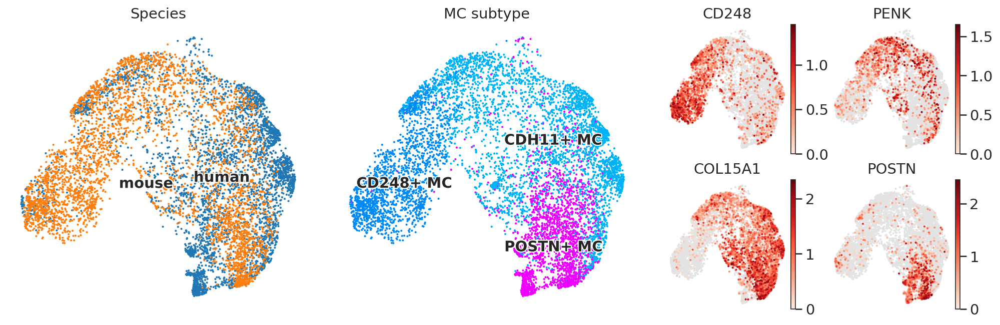

In [19]:
adata_MC = sc.read_h5ad(f"{PROJECT_DIR}/data/MouseHuman_our_conos.h5ad")
control_samples = ["SCG_65", "SCG_MTH2_C", "SCG_MTH3_C", "SCG_MTH4_C", "SCG_HTS1_20190722_F", "SCG_HTS1_20200302_M", "SCG_HTS1_20200309_F"]

fig = plt.figure(figsize=(22, 5))
ax_species = plt.subplot2grid((2, 8), (0, 0), colspan=2, rowspan=2)
sc.pl.umap(adata_MC[np.isin(adata_MC.obs.sample_id, control_samples)], color="species", ax=ax_species, frameon=False, title="Species",
           show=False, legend_loc="on data", legend_fontoutline=2)
ax_ct = plt.subplot2grid((2, 8), (0, 2), colspan=2, rowspan=2)
sc.pl.umap(adata_MC[np.isin(adata_MC.obs.sample_id, control_samples)], color="cell_type_integrated", ax=ax_ct, frameon=False, title="MC subtype",
           show=False, legend_loc="on data", legend_fontoutline=2)
ax_CD248 = plt.subplot2grid((2, 8), (0, 4))
sc.pl.umap(adata_MC[np.isin(adata_MC.obs.sample_id, control_samples)], color="CD248", ax=ax_CD248, cmap=Reds, show=False, frameon=False)
ax_COL15A1 = plt.subplot2grid((2, 8), (1, 4))
sc.pl.umap(adata_MC[np.isin(adata_MC.obs.sample_id, control_samples)], color="COL15A1", ax=ax_COL15A1, cmap=Reds, show=False, frameon=False)
ax_PENK = plt.subplot2grid((2, 8), (0, 5))
sc.pl.umap(adata_MC[np.isin(adata_MC.obs.sample_id, control_samples)], color="PENK", ax=ax_PENK, cmap=Reds, show=False, frameon=False)
ax_POSTN = plt.subplot2grid((2, 8), (1, 5))
sc.pl.umap(adata_MC[np.isin(adata_MC.obs.sample_id, control_samples)], color="POSTN", ax=ax_POSTN, cmap=Reds, show=False, frameon=False)

plt.savefig(f"{PROJECT_DIR}/figures/Fig2B.pdf", bbox_inches="tight")
del adata_MC, control_samples

### Figure 2C

In [21]:
adata_mouse_MC = sc.read_h5ad(f"{PROJECT_DIR}/data/Mouse_MC_conos.h5ad")
adata_mouse_MC = adata_mouse_MC[adata_mouse_MC.obs.condition == "control"]

In [22]:
GO_BP_mouse = pd.read_csv(f"{PROJECT_DIR}/data/GSEA/gene_sets/MSigDB_mouse_GO-BP.tsv", sep = "\t")
GO_CC_mouse = pd.read_csv(f"{PROJECT_DIR}/data/GSEA/gene_sets/MSigDB_mouse_GO-CC.tsv", sep = "\t")
GO_MF_mouse = pd.read_csv(f"{PROJECT_DIR}/data/GSEA/gene_sets/MSigDB_mouse_GO-MF.tsv", sep = "\t")
GO_mouse = pd.concat([GO_BP_mouse, GO_CC_mouse, GO_MF_mouse])

gene_sets_GO = {}
for gs in tqdm(set(GO_mouse.gs_name)):
    gene_sets_GO[gs] = list(GO_mouse[GO_mouse.gs_name == gs].gene_symbol)

  0%|          | 0/10183 [00:00<?, ?it/s]

In [23]:
selected_GOs = {
    "GOBP_T_CELL_MEDIATED_CYTOTOXICITY" : "T cell mediated toxicity",
    "GOBP_ANTIGEN_PROCESSING_AND_PRESENTATION_OF_ENDOGENOUS_ANTIGEN" : "Antigen processing and\npresentation of endogenous\nantigen",
    "GOBP_POSITIVE_REGULATION_OF_NATURAL_KILLER_CELL_MEDIATED_IMMUNITY" : "Positive regulation of NK cell\nmediated immunity",
    "GOCC_AUTOPHAGOSOME" : "Autophagosome",
    "GOBP_RESPONSE_TO_TYPE_I_INTERFERON" : "Response to type I interferon",
    "GOBP_POSITIVE_REGULATION_OF_FAT_CELL_DIFFERENTIATION" : "Positive regulation of\nfat cell differentiation",
    "GOCC_COLLAGEN_CONTAINING_EXTRACELLULAR_MATRIX" : "Collagen containing\nextracellular matrix"
}

for geneset_name in selected_GOs:
    sc.tl.score_genes(adata_mouse_MC, gene_list=gene_sets_GO[geneset_name], score_name=geneset_name)

computing score 'GOBP_T_CELL_MEDIATED_CYTOTOXICITY'
Trying to set attribute `.obs` of view, copying.
    finished: added
    'GOBP_T_CELL_MEDIATED_CYTOTOXICITY', score of gene set (adata.obs).
    750 total control genes are used. (0:00:00)
computing score 'GOBP_ANTIGEN_PROCESSING_AND_PRESENTATION_OF_ENDOGENOUS_ANTIGEN'
    finished: added
    'GOBP_ANTIGEN_PROCESSING_AND_PRESENTATION_OF_ENDOGENOUS_ANTIGEN', score of gene set (adata.obs).
    498 total control genes are used. (0:00:00)
computing score 'GOBP_POSITIVE_REGULATION_OF_NATURAL_KILLER_CELL_MEDIATED_IMMUNITY'
    finished: added
    'GOBP_POSITIVE_REGULATION_OF_NATURAL_KILLER_CELL_MEDIATED_IMMUNITY', score of gene set (adata.obs).
    650 total control genes are used. (0:00:00)
computing score 'GOCC_AUTOPHAGOSOME'
    finished: added
    'GOCC_AUTOPHAGOSOME', score of gene set (adata.obs).
    705 total control genes are used. (0:00:00)
computing score 'GOBP_RESPONSE_TO_TYPE_I_INTERFERON'
    finished: added
    'GOBP_RESPONSE

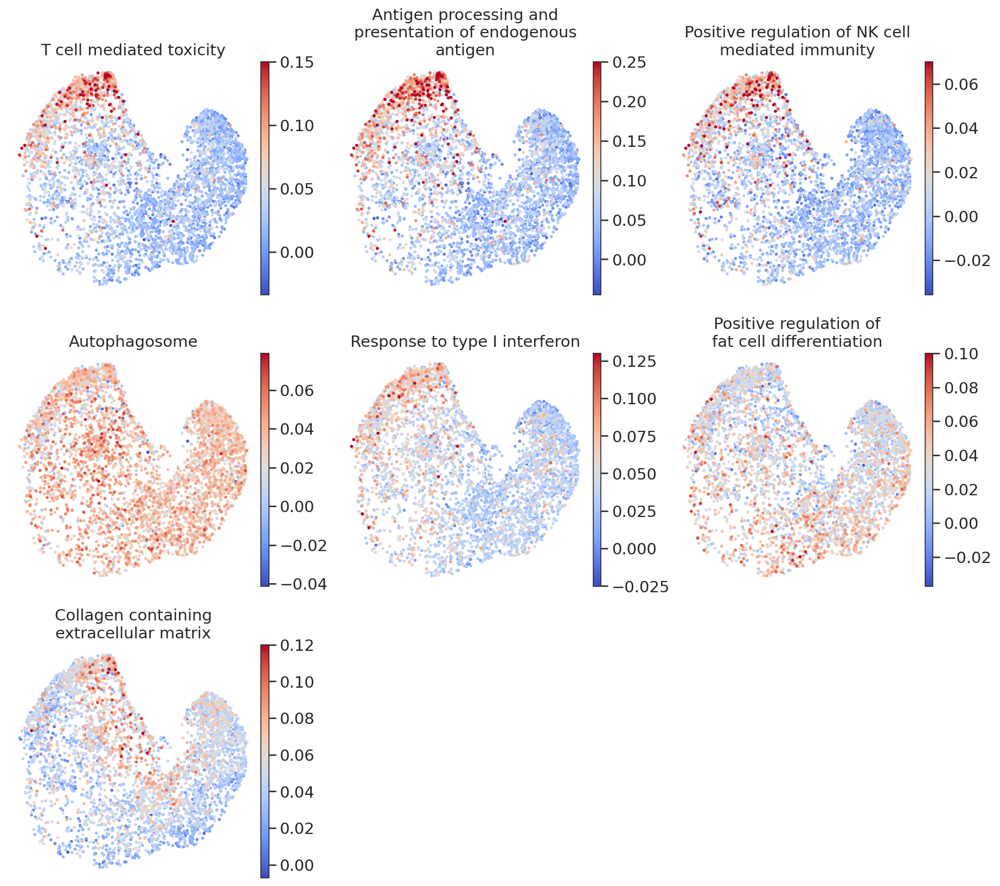

In [24]:
sc.pl.umap(
    adata_mouse_MC[adata_mouse_MC.obs.condition == "control"],
    frameon=False,
    color=list(selected_GOs.keys()),
    title=list(selected_GOs.values()),
    vmax=[0.15, 0.25, 0.07, None, 0.13, 0.1, 0.12],
    cmap="coolwarm",
    ncols=3,
    save="_Fig2C_extended.pdf"
)

In [26]:
Postn = pd.read_csv(f"{PROJECT_DIR}/data/GSEA/Postn.tsv", sep="\t",
                    index_col=0, usecols=["Term", "nes"]); Postn.columns = ["Postn"]
Cd248 = pd.read_csv(f"{PROJECT_DIR}/data/GSEA/Cd248.tsv", sep="\t",
                    index_col=0, usecols=["Term", "nes"]); Cd248.columns = ["Cd248"]
Cdh11 = pd.read_csv(f"{PROJECT_DIR}/data/GSEA/Cdh11.tsv", sep="\t",
                    index_col=0, usecols=["Term", "nes"]); Cdh11.columns = ["Cdh11"]
signatures = pd.concat([Cd248, Cdh11, Postn], axis=1)

Postn = pd.read_csv(f"{PROJECT_DIR}/data/GSEA/Postn.tsv", sep="\t",
                    index_col=0, usecols=["Term", "fdr"]); Postn.columns = ["Postn"]
Cd248 = pd.read_csv(f"{PROJECT_DIR}/data/GSEA/Cd248.tsv", sep="\t",
                    index_col=0, usecols=["Term", "fdr"]); Cd248.columns = ["Cd248"]
Cdh11 = pd.read_csv(f"{PROJECT_DIR}/data/GSEA/Cdh11.tsv", sep="\t",
                    index_col=0, usecols=["Term", "fdr"]); Cdh11.columns = ["Cdh11"]
FDRs = pd.concat([Cd248, Cdh11, Postn], axis=1)

for celltype in FDRs.columns:
    FDRs[celltype] = FDRs[celltype].apply(pval_to_star)

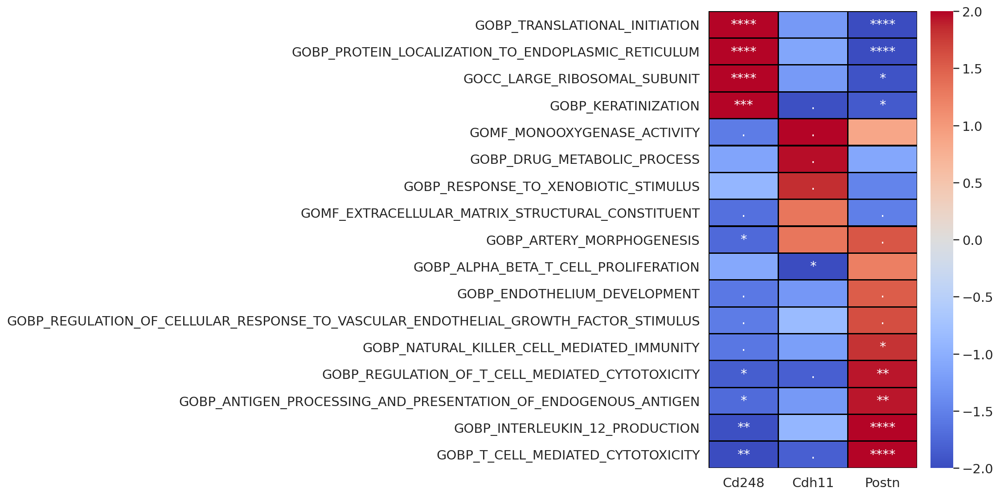

In [27]:
GOs = [
    "GOBP_TRANSLATIONAL_INITIATION", "GOBP_PROTEIN_LOCALIZATION_TO_ENDOPLASMIC_RETICULUM",
    "GOCC_LARGE_RIBOSOMAL_SUBUNIT", "GOBP_KERATINIZATION", 
    
    
    "GOMF_MONOOXYGENASE_ACTIVITY", "GOBP_DRUG_METABOLIC_PROCESS", "GOBP_RESPONSE_TO_XENOBIOTIC_STIMULUS",
    "GOMF_EXTRACELLULAR_MATRIX_STRUCTURAL_CONSTITUENT", 
    
    "GOBP_ARTERY_MORPHOGENESIS", "GOBP_ALPHA_BETA_T_CELL_PROLIFERATION", "GOBP_ENDOTHELIUM_DEVELOPMENT",
    "GOBP_REGULATION_OF_CELLULAR_RESPONSE_TO_VASCULAR_ENDOTHELIAL_GROWTH_FACTOR_STIMULUS",
    "GOBP_NATURAL_KILLER_CELL_MEDIATED_IMMUNITY", "GOBP_REGULATION_OF_T_CELL_MEDIATED_CYTOTOXICITY",
    "GOBP_ANTIGEN_PROCESSING_AND_PRESENTATION_OF_ENDOGENOUS_ANTIGEN", "GOBP_INTERLEUKIN_12_PRODUCTION",
    "GOBP_T_CELL_MEDIATED_CYTOTOXICITY"
]

fig, ax = plt.subplots(dpi=150, figsize=(5, 9))

sns.heatmap(signatures.loc[GOs], vmin=-2, vmax=2, cmap="coolwarm", linewidths=1,
            linecolor="black", ax=ax, annot=FDRs.loc[GOs], fmt="")

fig.tight_layout()

plt.savefig(f"{PROJECT_DIR}/figures/Fig2C.pdf", bbox_inches="tight")

### Difure 2D

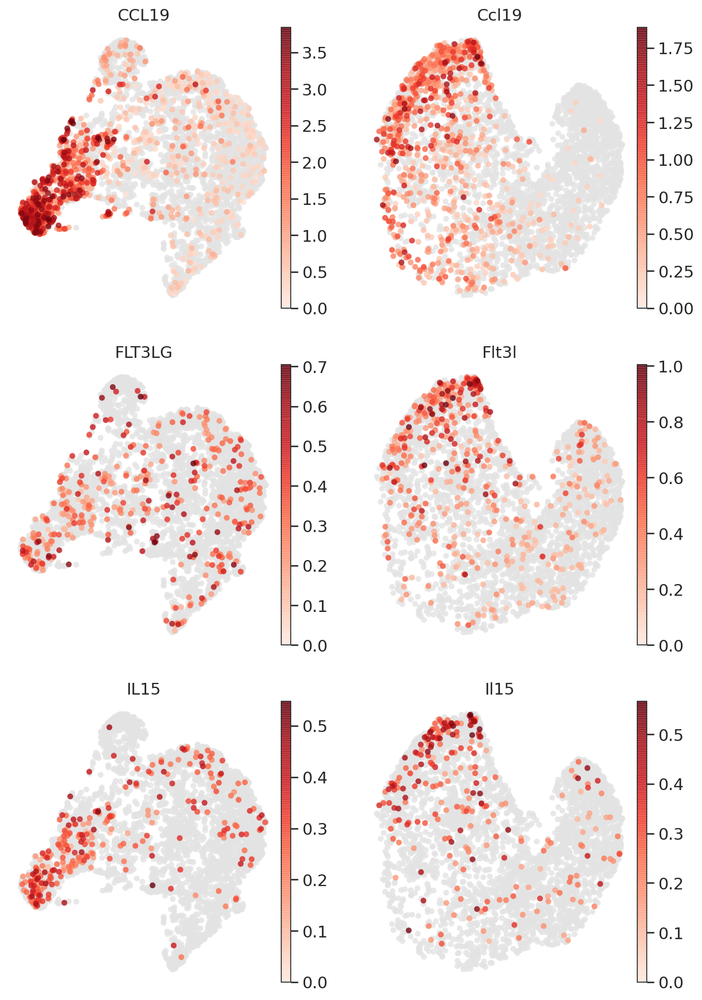

In [29]:
adata_mouse_MC = sc.read_h5ad(f"{PROJECT_DIR}/data/Mouse_MC_conos.h5ad")
adata_mouse_MC = adata_mouse_MC[adata_mouse_MC.obs.condition == "control"]
adata_human_MC = sc.read_h5ad(f"{PROJECT_DIR}/data/Human_MC_conos.h5ad")

fig, axes = plt.subplots(ncols=2, nrows=3, figsize=(10, 15), dpi=150)

sc.pl.umap(adata_human_MC, color="CCL19", cmap=Reds, ax=axes[0, 0], show=False, s=100, alpha=0.8, frameon=False)
sc.pl.umap(adata_human_MC, color="FLT3LG", cmap=Reds, ax=axes[1, 0], show=False, s=100, alpha=0.8, frameon=False)
sc.pl.umap(adata_human_MC, color="IL15", cmap=Reds, ax=axes[2, 0], show=False, s=100, alpha=0.8, frameon=False)

sc.pl.umap(adata_mouse_MC, color="Ccl19", cmap=Reds, ax=axes[0, 1], show=False, s=100, alpha=0.8, frameon=False)
sc.pl.umap(adata_mouse_MC, color="Flt3l", cmap=Reds, ax=axes[1, 1], show=False, s=100, alpha=0.8, frameon=False)
sc.pl.umap(adata_mouse_MC, color="Il15", cmap=Reds, ax=axes[2, 1], show=False, s=100, alpha=0.8, frameon=False)

plt.savefig(f"{PROJECT_DIR}/figures/Fig2D.pdf", bbox_inches="tight")

del adata_mouse_MC, adata_human_MC

### Figure 2G

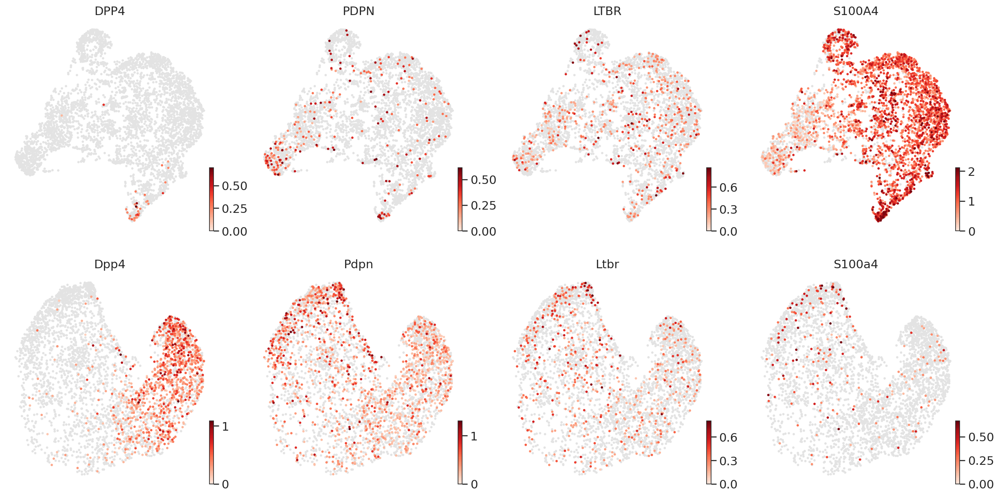

In [30]:
adata_human = sc.read_h5ad(f"{PROJECT_DIR}/data/Human_MC_conos.h5ad")
adata_mouse = sc.read_h5ad(f"{PROJECT_DIR}/data/Mouse_MC_conos.h5ad")

fig, axes = plt.subplots(ncols=4, nrows=2, figsize=(20, 10), dpi=150)

scv.pl.umap(adata_human, color="DPP4", ax=axes[0, 0], show=False, cmap=Reds)
scv.pl.umap(adata_human, color="PDPN", ax=axes[0, 1], show=False, cmap=Reds)
scv.pl.umap(adata_human, color="LTBR", ax=axes[0, 2], show=False, cmap=Reds)
scv.pl.umap(adata_human, color="S100A4", ax=axes[0, 3], show=False, cmap=Reds)

scv.pl.umap(adata_mouse[adata_mouse.obs.condition == "control"], color="Dpp4", ax=axes[1, 0], show=False, cmap=Reds)
scv.pl.umap(adata_mouse[adata_mouse.obs.condition == "control"], color="Pdpn", ax=axes[1, 1], show=False, cmap=Reds)
scv.pl.umap(adata_mouse[adata_mouse.obs.condition == "control"], color="Ltbr", ax=axes[1, 2], show=False, cmap=Reds)
scv.pl.umap(adata_mouse[adata_mouse.obs.condition == "control"], color="S100a4", ax=axes[1, 3], show=False, cmap=Reds)

plt.savefig(f"{PROJECT_DIR}/figures/Fig2G.pdf", bbox_inches="tight")

del adata_human, adata_mouse

## Figure 3

### Figure 3D-G

In [31]:
adata_mouse_MC = sc.read_h5ad(f"{PROJECT_DIR}/data/Mouse_MC_conos.h5ad")
adata_mouse_MC.obs.to_csv(f"{PROJECT_DIR}/data/Mouse_MC_pagoda2_conos/cell_types.csv")

adata_mouse_SC = sc.read_h5ad(f"{PROJECT_DIR}/data/Mouse_SC_conos.h5ad")
get_cluster_sizes(adata_mouse_SC, cluster_key="cell_type_l2", sample_key="sample_id").to_csv(f"{PROJECT_DIR}/figures/Fig3H-E.tsv", sep="\t")

In [33]:
%%R
library(ggplot2)
library(DescTools)
library(cowplot)
library(patchwork)
library(conos)
library(cacoa)

R[write to console]: 
Attaching package: ‘DescTools’


R[write to console]: The following object is masked from ‘package:igraph’:

    %c%


R[write to console]: 
Attaching package: ‘patchwork’


R[write to console]: The following object is masked from ‘package:cowplot’:

    align_plots


R[write to console]: 



In [34]:
%%R

sample.groups <- setNames(
  c("Control", "Control", "Control", "Control",
    "Aged", "Aged", "Aged", "Aged",
    "Transplantation", "Transplantation", "Transplantation",
    "IL7_KO", "IL7_KO", "IL7_KO", "IL7_KO"),
  c("SCG_65", "SCG_MTH2_C", "SCG_MTH3_C", "SCG_MTH4_C",
    "ID_MTH9_Old_M1", "ID_MTH9_Old_F3", "ID_MTH9_Old_M2", "ID_MTH9_Old_F4",
    "SCG_MTH2_IR", "ID_MTH5_IR", "SCG_MTH7_IR",
    "SCG_MTH3_IL7_C", "ID_MTH5_IL7_C", "SCG_MTH8_IL7_C1", "SCG_MTH8_IL7_C2")
)

MC.con <- readRDS("/home/sisaev/projects/Gustafsson_et_al_2022/data/Mouse_MC_pagoda2_conos/conos.rds")
MC_annotation_df <- read.table("/home/sisaev/projects/Gustafsson_et_al_2022/data/Mouse_MC_pagoda2_conos/annotation.csv",
                               sep = ",", header = 1, row.names = 1)

MC.cao <- Cacoa$new(
  MC.con,
  cell.groups = setNames(object = MC_annotation_df$cell_type_l2, rownames(MC_annotation_df)),
  sample.groups = sample.groups,
  ref.level = "Control",
  target.level = "Aged",
  embedding = MC.con$embeddings$UMAP
)
MC.cao$estimateCellDensity()

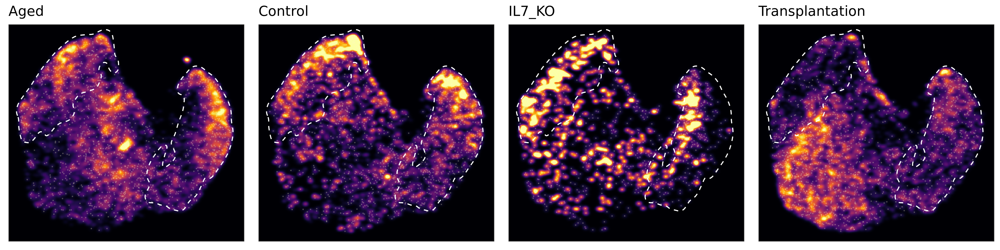

In [35]:
%%R -w 4000 -h 1000 -r 300

pl <- MC.cao$plotCellDensity(
  contours = c("Postn+ MC", "Cd248+ MC"),
  add.points = TRUE,
  show.grid = FALSE,
  show.cell.groups = FALSE
)
plot_grid(plotlist = pl, nrow = 1)

In [ ]:
del adata_mouse_MC, adata_mouse_SC

In [36]:
%%R
rm()

### Figure 3F

In [39]:
Postn_IR = pd.read_csv(f"{PROJECT_DIR}/data/GSEA/Postn_IR.tsv", sep="\t",
                       index_col=0, usecols=["Term", "nes"]); Postn_IR.columns = ["Postn"]
Cdh11_IR = pd.read_csv(f"{PROJECT_DIR}/data/GSEA/Cdh11_IR.tsv", sep="\t",
                       index_col=0, usecols=["Term", "nes"]); Cdh11_IR.columns = ["Cdh11"]
Cd248_IR = pd.read_csv(f"{PROJECT_DIR}/data/GSEA/Cd248_IR.tsv", sep="\t",
                       index_col=0, usecols=["Term", "nes"]); Cd248_IR.columns = ["Cd248"]
signatures_IR = pd.concat([Cd248_IR, Cdh11_IR, Postn_IR], axis=1)

Postn_IR = pd.read_csv(f"{PROJECT_DIR}/data/GSEA/Postn_IR.tsv", sep="\t",
                       index_col=0, usecols=["Term", "fdr"]); Postn_IR.columns = ["Postn"]
Cdh11_IR = pd.read_csv(f"{PROJECT_DIR}/data/GSEA/Cdh11_IR.tsv", sep="\t",
                       index_col=0, usecols=["Term", "fdr"]); Cdh11_IR.columns = ["Cdh11"]
Cd248_IR = pd.read_csv(f"{PROJECT_DIR}/data/GSEA/Cd248_IR.tsv", sep="\t",
                       index_col=0, usecols=["Term", "fdr"]); Cd248_IR.columns = ["Cd248"]
FDRs_IR = pd.concat([Cd248_IR, Cdh11_IR, Postn_IR], axis=1).fillna(value=1)

for celltype in FDRs_IR.columns:
    FDRs_IR[celltype] = FDRs_IR[celltype].apply(pval_to_star)

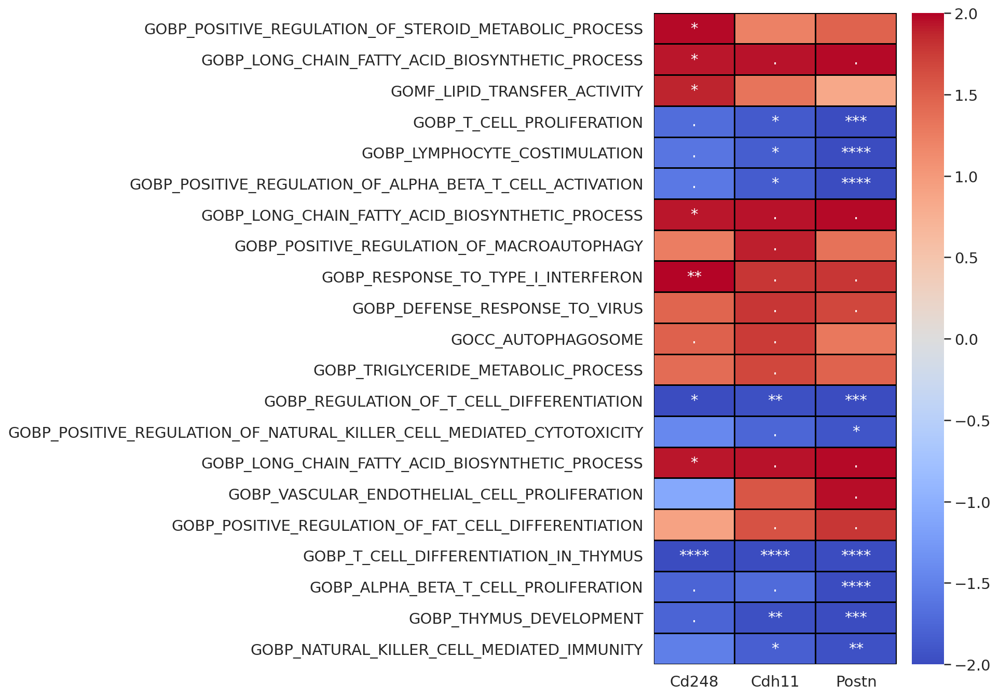

In [41]:
GOs_IR = [
    "GOBP_POSITIVE_REGULATION_OF_STEROID_METABOLIC_PROCESS", "GOBP_LONG_CHAIN_FATTY_ACID_BIOSYNTHETIC_PROCESS",
    "GOMF_LIPID_TRANSFER_ACTIVITY", "GOBP_T_CELL_PROLIFERATION", "GOBP_LYMPHOCYTE_COSTIMULATION",
    "GOBP_POSITIVE_REGULATION_OF_ALPHA_BETA_T_CELL_ACTIVATION",
    
    "GOBP_LONG_CHAIN_FATTY_ACID_BIOSYNTHETIC_PROCESS", "GOBP_POSITIVE_REGULATION_OF_MACROAUTOPHAGY",
    "GOBP_RESPONSE_TO_TYPE_I_INTERFERON", "GOBP_DEFENSE_RESPONSE_TO_VIRUS", "GOCC_AUTOPHAGOSOME",
    "GOBP_TRIGLYCERIDE_METABOLIC_PROCESS", "GOBP_REGULATION_OF_T_CELL_DIFFERENTIATION",
    "GOBP_POSITIVE_REGULATION_OF_NATURAL_KILLER_CELL_MEDIATED_CYTOTOXICITY",
    
    "GOBP_LONG_CHAIN_FATTY_ACID_BIOSYNTHETIC_PROCESS", "GOBP_VASCULAR_ENDOTHELIAL_CELL_PROLIFERATION",
    "GOBP_POSITIVE_REGULATION_OF_FAT_CELL_DIFFERENTIATION", "GOBP_T_CELL_DIFFERENTIATION_IN_THYMUS",
    "GOBP_ALPHA_BETA_T_CELL_PROLIFERATION", "GOBP_THYMUS_DEVELOPMENT", "GOBP_NATURAL_KILLER_CELL_MEDIATED_IMMUNITY"
]

fig, ax = plt.subplots(dpi=150, figsize=(5, 11))

sns.heatmap(signatures_IR.loc[GOs_IR], vmin=-2, vmax=2, cmap="coolwarm", linewidths=1,
            linecolor="black", ax=ax, annot=FDRs_IR.loc[GOs_IR], fmt="")

fig.tight_layout()

plt.savefig(f"{PROJECT_DIR}/figures/Fig3F_IR.pdf", bbox_inches="tight")

In [42]:
Postn_aged = pd.read_csv(f"{PROJECT_DIR}/data/GSEA/Postn_aged.tsv", sep="\t",
                         index_col=0, usecols=["Term", "nes"]); Postn_aged.columns = ["Postn"]
Cdh11_aged = pd.read_csv(f"{PROJECT_DIR}/data/GSEA/Cdh11_aged.tsv", sep="\t",
                       index_col=0, usecols=["Term", "nes"]); Cdh11_aged.columns = ["Cdh11"]
Cd248_aged = pd.read_csv(f"{PROJECT_DIR}/data/GSEA/Cd248_aged.tsv", sep="\t",
                       index_col=0, usecols=["Term", "nes"]); Cd248_aged.columns = ["Cd248"]
signatures_aged = pd.concat([Cd248_aged, Cdh11_aged, Postn_aged], axis=1)

Postn_aged = pd.read_csv(f"{PROJECT_DIR}/data/GSEA/Postn_aged.tsv", sep="\t",
                       index_col=0, usecols=["Term", "fdr"]); Postn_aged.columns = ["Postn"]
Cdh11_aged = pd.read_csv(f"{PROJECT_DIR}/data/GSEA/Cdh11_aged.tsv", sep="\t",
                       index_col=0, usecols=["Term", "fdr"]); Cdh11_aged.columns = ["Cdh11"]
Cd248_aged = pd.read_csv(f"{PROJECT_DIR}/data/GSEA/Cd248_aged.tsv", sep="\t",
                       index_col=0, usecols=["Term", "fdr"]); Cd248_aged.columns = ["Cd248"]
FDRs_aged = pd.concat([Cd248_aged, Cdh11_aged, Postn_aged], axis=1).fillna(value=1)

for celltype in FDRs_aged.columns:
    FDRs_aged[celltype] = FDRs_aged[celltype].apply(pval_to_star)

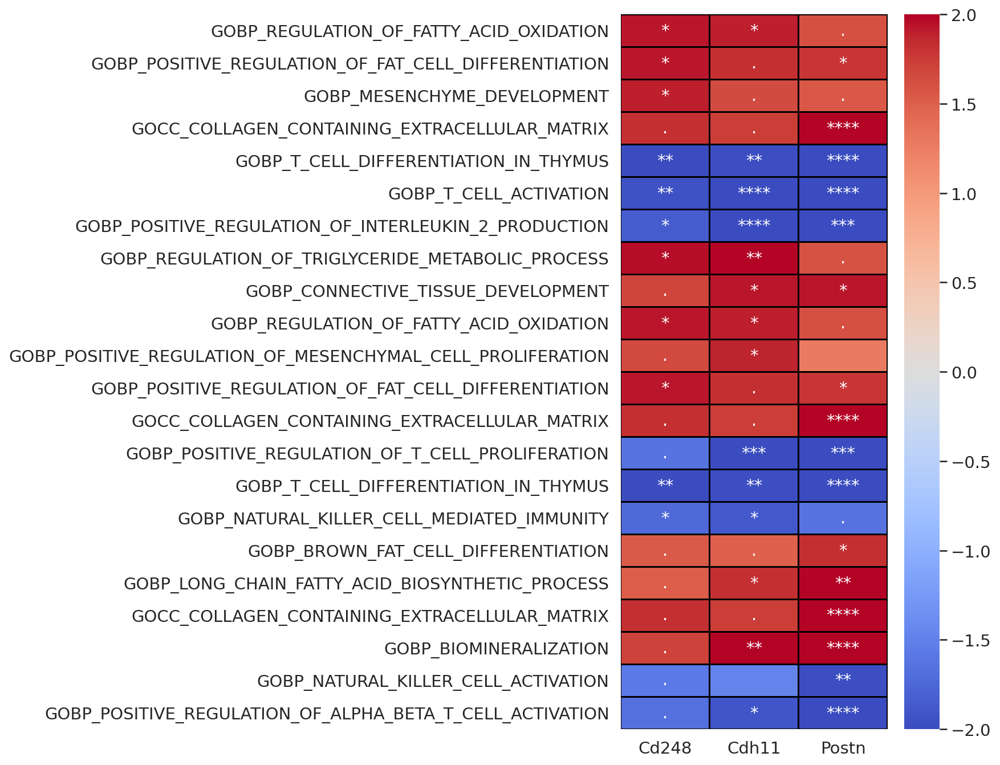

In [43]:
GOs_aged = [
    "GOBP_REGULATION_OF_FATTY_ACID_OXIDATION", "GOBP_POSITIVE_REGULATION_OF_FAT_CELL_DIFFERENTIATION",
    "GOBP_MESENCHYME_DEVELOPMENT", "GOCC_COLLAGEN_CONTAINING_EXTRACELLULAR_MATRIX",
    "GOBP_T_CELL_DIFFERENTIATION_IN_THYMUS", "GOBP_T_CELL_ACTIVATION", "GOBP_POSITIVE_REGULATION_OF_INTERLEUKIN_2_PRODUCTION",
    
    "GOBP_REGULATION_OF_TRIGLYCERIDE_METABOLIC_PROCESS", "GOBP_CONNECTIVE_TISSUE_DEVELOPMENT",
    "GOBP_REGULATION_OF_FATTY_ACID_OXIDATION", "GOBP_POSITIVE_REGULATION_OF_MESENCHYMAL_CELL_PROLIFERATION",
    "GOBP_POSITIVE_REGULATION_OF_FAT_CELL_DIFFERENTIATION", "GOCC_COLLAGEN_CONTAINING_EXTRACELLULAR_MATRIX",
    "GOBP_POSITIVE_REGULATION_OF_T_CELL_PROLIFERATION", "GOBP_T_CELL_DIFFERENTIATION_IN_THYMUS", 
    "GOBP_NATURAL_KILLER_CELL_MEDIATED_IMMUNITY",
    
    "GOBP_BROWN_FAT_CELL_DIFFERENTIATION", "GOBP_LONG_CHAIN_FATTY_ACID_BIOSYNTHETIC_PROCESS",
    "GOCC_COLLAGEN_CONTAINING_EXTRACELLULAR_MATRIX", "GOBP_BIOMINERALIZATION", "GOBP_NATURAL_KILLER_CELL_ACTIVATION",
    "GOBP_POSITIVE_REGULATION_OF_ALPHA_BETA_T_CELL_ACTIVATION"
]

fig, ax = plt.subplots(dpi=150, figsize=(5, 11))

sns.heatmap(signatures_aged.loc[GOs_aged], vmin=-2, vmax=2, cmap="coolwarm", linewidths=1,
            linecolor="black", ax=ax, annot=FDRs_aged.loc[GOs_aged], fmt="")

fig.tight_layout()

plt.savefig(f"{PROJECT_DIR}/figures/Fig3F_aged.pdf", bbox_inches="tight")

### Figure 3H

In [44]:
adata_mouse_SC = sc.read_h5ad(f"{PROJECT_DIR}/data/Mouse_SC_conos.h5ad")

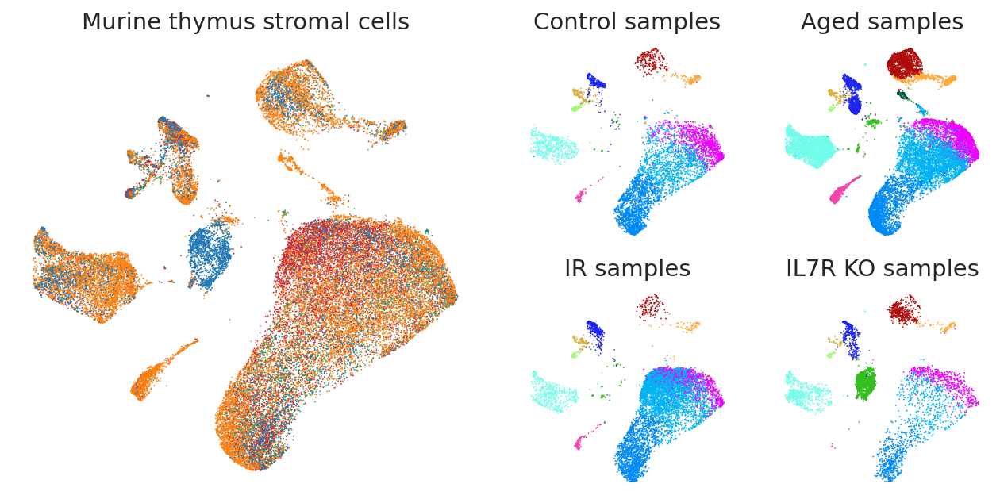

In [45]:
fig = plt.figure(figsize=(16, 5))

ax_all = plt.subplot2grid((2, 6), (0, 0), colspan=2, rowspan=2)
sc.pl.umap(adata_mouse_SC, color="condition", frameon=False, title="Murine thymus stromal cells", legend_loc="right", ax=ax_all, show=False, s=3)
ax_control = plt.subplot2grid((2, 6), (0, 2))
sc.pl.umap(adata_mouse_SC[adata_mouse_SC.obs.condition == "control"], color="cell_type_l2", frameon=False, title="Control samples", legend_loc=None, ax=ax_control, show=False, s=3)
ax_IR = plt.subplot2grid((2, 6), (1, 2))
sc.pl.umap(adata_mouse_SC[adata_mouse_SC.obs.condition == "irradiated"], color="cell_type_l2", frameon=False, title="IR samples", legend_loc=None, ax=ax_IR, show=False, s=3)
ax_aged = plt.subplot2grid((2, 6), (0, 3))
sc.pl.umap(adata_mouse_SC[adata_mouse_SC.obs.condition == "aged"], color="cell_type_l2", frameon=False, title="Aged samples", legend_loc=None, ax=ax_aged, show=False, s=3)
ax_IL7 = plt.subplot2grid((2, 6), (1, 3))
sc.pl.umap(adata_mouse_SC[adata_mouse_SC.obs.condition == "IL7_ko"], color="cell_type_l2", frameon=False, title="IL7R KO samples", legend_loc=None, ax=ax_IL7, show=False, s=3)

plt.savefig(f"{PROJECT_DIR}/figures/Fig3H.pdf", bbox_inches="tight")

In [46]:
del adata_mouse_SC

## Supplementary Figure 1

### Figure S1C

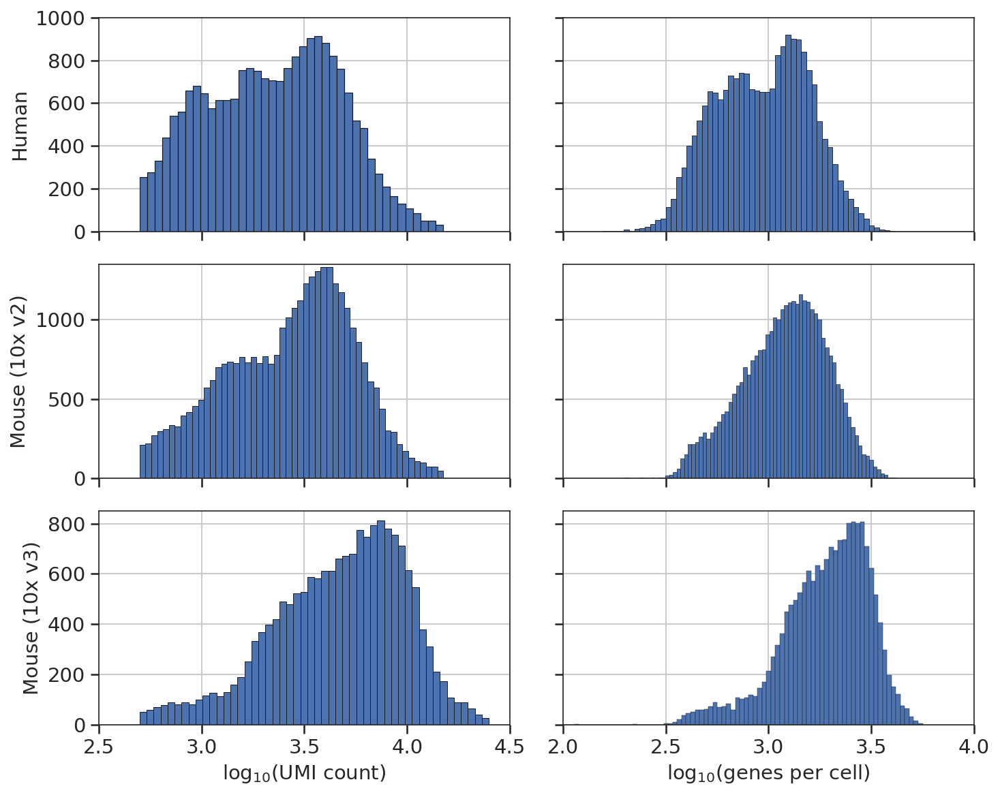

In [47]:
adata_mouse = sc.read_h5ad(f"{PROJECT_DIR}/data/Mouse_AllCells_conos.h5ad")
adata_human = sc.read_h5ad(f"{PROJECT_DIR}/data/Human_AllCells_conos.h5ad")

control_samples = ["SCG_65", "SCG_MTH2_C", "SCG_MTH3_C", "SCG_MTH4_C"]
IL7_ko_samples = ["SCG_MTH3_IL7_C", "ID_MTH5_IL7_C", "SCG_MTH8_IL7_C1", "SCG_MTH8_IL7_C2"]
aged_samples = ["ID_MTH9_Old_M1", "ID_MTH9_Old_M2", "ID_MTH9_Old_F3", "ID_MTH9_Old_F4"]
IR_samples = ["SCG_MTH2_IR", "ID_MTH5_IR", "SCG_MTH7_IR"]

v2_samples = control_samples + IL7_ko_samples + IR_samples
v3_samples = aged_samples

sns.set_style("ticks")

fig, axes = plt.subplots(dpi=150, figsize=(10, 8), ncols=2, nrows=3)
sns.histplot(x=np.log10(adata_human.obs.total_counts), ax=axes[0, 0], alpha=1, edgecolor="k")
axes[0, 0].set_xlabel("")
axes[0, 0].set_ylabel("Human")
axes[0, 0].set_xlim(2.5, 4.5)
axes[0, 0].set_ylim(0, 1000)
axes[0, 0].grid(True)
axes[0, 0].set_xticklabels([])

sns.histplot(x=np.log10(adata_human.obs.n_genes_by_counts), ax=axes[0, 1], alpha=1, edgecolor="k")
axes[0, 1].set_xlabel("")
axes[0, 1].set_ylabel("")
axes[0, 1].set_xlim(2, 4)
axes[0, 1].set_ylim(0, 1000)
axes[0, 1].grid(True)
axes[0, 1].set_xticklabels([])
axes[0, 1].set_yticklabels([])

sns.histplot(x=np.log10(adata_mouse[np.isin(adata_mouse.obs.sample_id, v2_samples)].obs.total_counts), ax=axes[1, 0], alpha=1, edgecolor="k")
axes[1, 0].set_ylabel("Mouse (10x v2)")
axes[1, 0].set_xlabel("")
axes[1, 0].set_xlim(2.5, 4.5)
axes[1, 0].set_ylim(0, 1350)
axes[1, 0].grid(True)
axes[1, 0].set_xticklabels([])

sns.histplot(x=np.log10(adata_mouse[np.isin(adata_mouse.obs.sample_id, v2_samples)].obs.n_genes_by_counts), ax=axes[1, 1], alpha=1, edgecolor="k")
axes[1, 1].set_ylabel("")
axes[1, 1].set_xlabel("")
axes[1, 1].set_xlim(2, 4)
axes[1, 1].set_ylim(0, 1350)
axes[1, 1].grid(True)
axes[1, 1].set_xticklabels([])
axes[1, 1].set_yticklabels([])

sns.histplot(x=np.log10(adata_mouse[np.isin(adata_mouse.obs.sample_id, v3_samples)].obs.total_counts), ax=axes[2, 0], alpha=1, edgecolor="k")
axes[2, 0].set_ylabel("Mouse (10x v3)")
axes[2, 0].set_xlabel("log$_{10}$(UMI count)")
axes[2, 0].set_ylim(0, 850)
axes[2, 0].set_xlim(2.5, 4.5)
axes[2, 0].grid(True)

sns.histplot(x=np.log10(adata_mouse[np.isin(adata_mouse.obs.sample_id, v3_samples)].obs.n_genes_by_counts), ax=axes[2, 1], alpha=1, edgecolor="k")
axes[2, 1].set_ylabel("")
axes[2, 1].set_xlabel("log$_{10}$(genes per cell)")
axes[2, 1].set_xlim(2, 4)
axes[2, 1].set_ylim(0, 850)
axes[2, 1].grid(True)
axes[2, 1].set_yticklabels([])

fig.tight_layout()
plt.savefig(f"{PROJECT_DIR}/figures/FigS1C.pdf", bbox_inches="tight")

del adata_mouse, adata_human

### Figure S1D

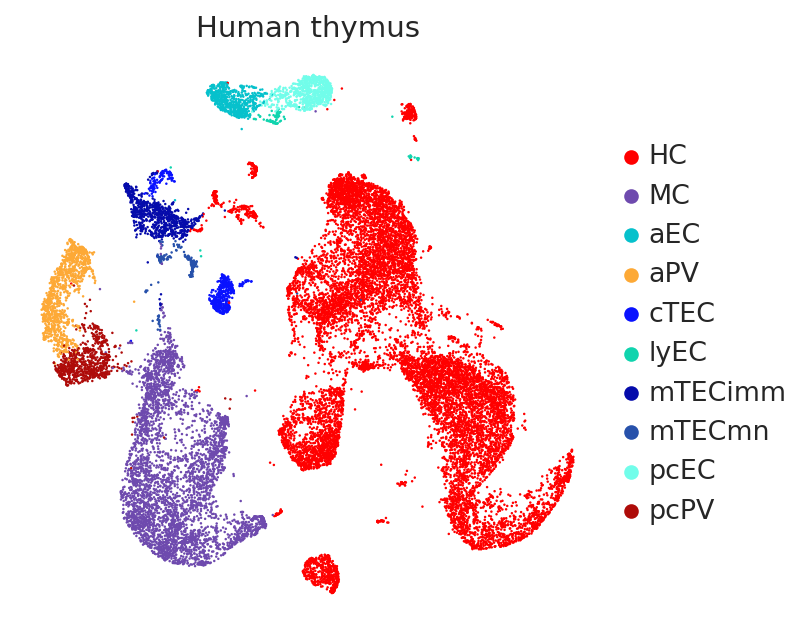

In [48]:
adata_human = sc.read_h5ad(f"{PROJECT_DIR}/data/Human_AllCells_conos.h5ad")

fig, ax = plt.subplots(dpi=150, figsize=(5, 5))
sc.pl.umap(
    adata_human,
    color="cell_type",
    frameon=False,
    title="Human thymus",
    ax=ax,
    show=False
)
plt.savefig(f"{PROJECT_DIR}/figures/FigS1D.pdf", bbox_inches="tight")

del adata_human

### Figure S1E

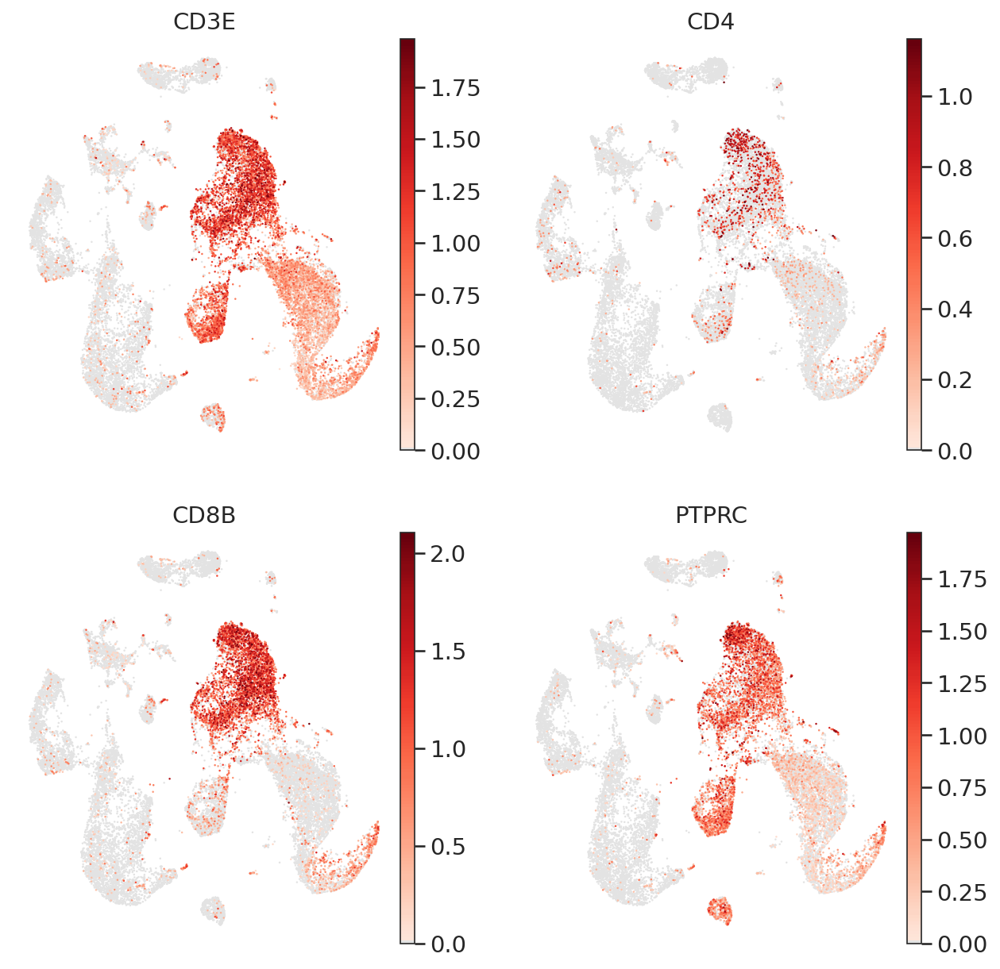

In [49]:
adata_human = sc.read_h5ad(f"{PROJECT_DIR}/data/Human_AllCells_conos.h5ad")

fig, axes = plt.subplots(dpi=150, figsize=(10, 10), ncols=2, nrows=2)

sc.pl.umap(adata_human, color="CD3E", ax=axes[0, 0], show=False, cmap=Reds, frameon=False)
sc.pl.umap(adata_human, color="CD4", ax=axes[0, 1], show=False, cmap=Reds, frameon=False)
sc.pl.umap(adata_human, color="CD8B", ax=axes[1, 0], show=False, cmap=Reds, frameon=False)
sc.pl.umap(adata_human, color="PTPRC", ax=axes[1, 1], show=False, cmap=Reds, frameon=False)

plt.savefig(f"{PROJECT_DIR}/figures/FigS1E.pdf", bbox_inches="tight")

del adata_human

### Figure S1F

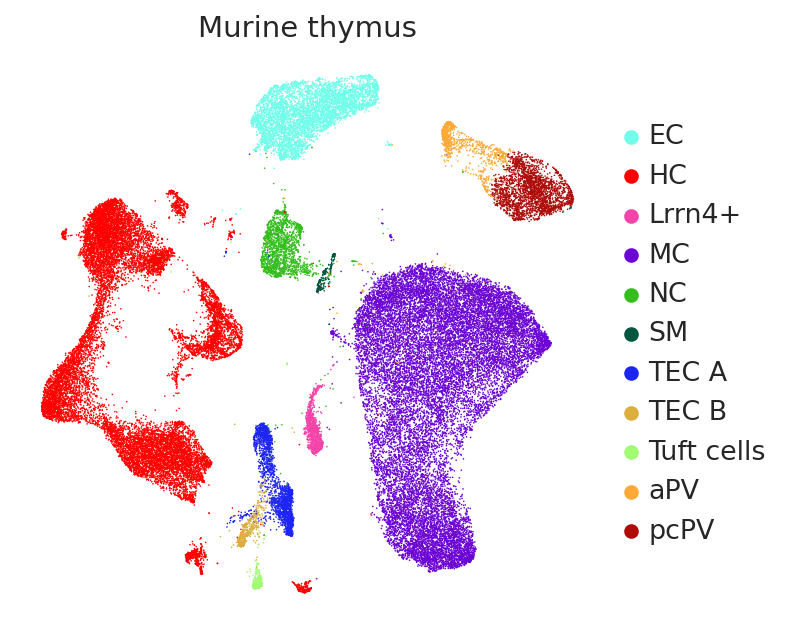

In [50]:
adata_mouse = sc.read_h5ad(f"{PROJECT_DIR}/data/Mouse_AllCells_conos.h5ad")

fig, ax = plt.subplots(dpi=150, figsize=(5, 5))
sc.pl.umap(
    adata_mouse,
    color="cell_type",
    frameon=False,
    title="Murine thymus",
    ax=ax,
    show=False
)
plt.savefig(f"{PROJECT_DIR}/figures/FigS1F.pdf", bbox_inches="tight")

del adata_mouse

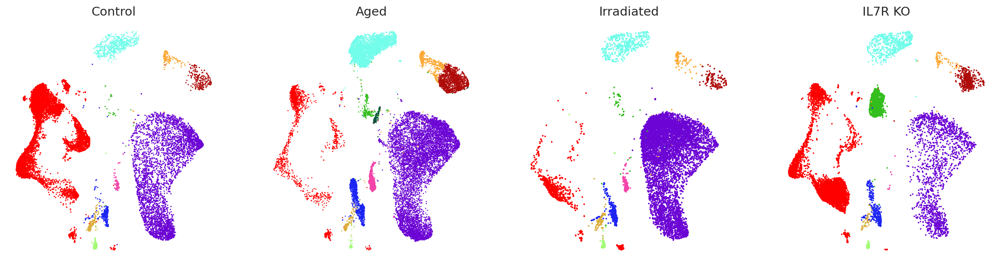

In [51]:
adata_mouse = sc.read_h5ad(f"{PROJECT_DIR}/data/Mouse_AllCells_conos.h5ad")
fig, axes = plt.subplots(ncols=4, dpi=150, figsize=(20, 5))

sc.pl.umap(adata_mouse[adata_mouse.obs.condition == "control"], color="cell_type", title="Control", frameon=False, ax=axes[0], show=False, legend_loc=None)
sc.pl.umap(adata_mouse[adata_mouse.obs.condition == "aged"], color="cell_type", title="Aged", frameon=False, ax=axes[1], show=False, legend_loc=None)
sc.pl.umap(adata_mouse[adata_mouse.obs.condition == "irradiated"], color="cell_type", title="Irradiated", frameon=False, ax=axes[2], show=False, legend_loc=None)
sc.pl.umap(adata_mouse[adata_mouse.obs.condition == "IL7_ko"], color="cell_type", title="IL7R KO", frameon=False, ax=axes[3], show=False, legend_loc=None)

del adata_mouse

### Figure S1G

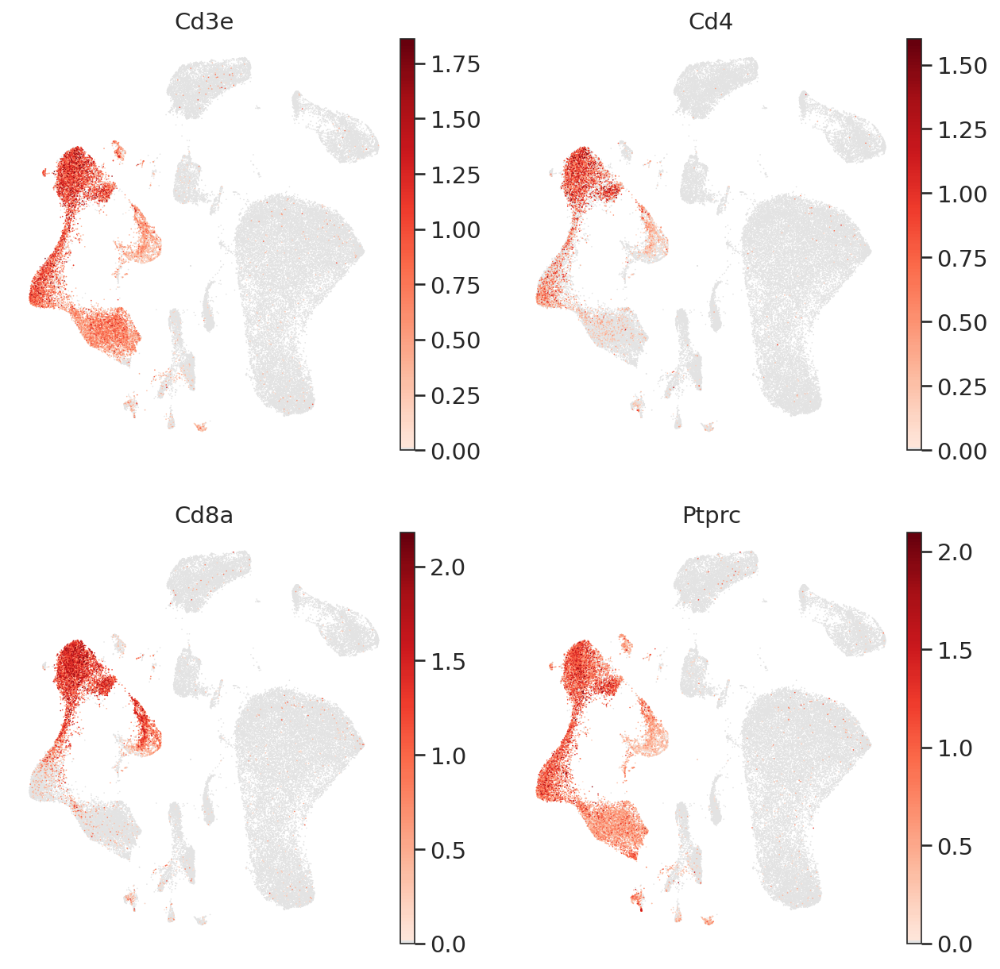

In [52]:
adata_mouse = sc.read_h5ad(f"{PROJECT_DIR}/data/Mouse_AllCells_conos.h5ad")

fig, axes = plt.subplots(dpi=150, figsize=(10, 10), ncols=2, nrows=2)

sc.pl.umap(adata_mouse, color="Cd3e", ax=axes[0, 0], show=False, cmap=Reds, frameon=False)
sc.pl.umap(adata_mouse, color="Cd4", ax=axes[0, 1], show=False, cmap=Reds, frameon=False)
sc.pl.umap(adata_mouse, color="Cd8a", ax=axes[1, 0], show=False, cmap=Reds, frameon=False)
sc.pl.umap(adata_mouse, color="Ptprc", ax=axes[1, 1], show=False, cmap=Reds, frameon=False)

plt.savefig(f"{PROJECT_DIR}/figures/FigS1G.pdf", bbox_inches="tight")

del adata_mouse

## Supplementary Figure 2

### Figure S2A

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:24)
... as `zero_center=True`, sparse input is densified and may lead to large memory consumption


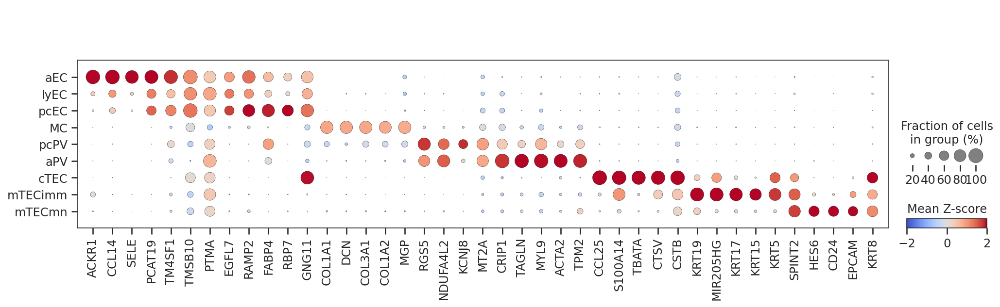

In [53]:
adata = sc.read_h5ad(f"{PROJECT_DIR}/data/Human_SC_conos.h5ad")
adata.obs.cell_type = adata.obs.cell_type.cat.reorder_categories(["aEC", "lyEC", "pcEC", "MC", "pcPV", "aPV", "cTEC", "mTECimm", "mTECmn"])

sc.tl.rank_genes_groups(adata, groupby="cell_type", method="wilcoxon")
adata.layers["z-score"] = adata.X.copy()
sc.pp.scale(adata, layer="z-score")

genes_to_draw = []
n_genes = 5

for group in ["aEC", "lyEC", "pcEC", "MC", "pcPV", "aPV", "cTEC", "mTECimm", "mTECmn"]:
    for gene in adata.uns["rank_genes_groups"]["names"][group][:n_genes]:
        if gene not in genes_to_draw:
            genes_to_draw.append(gene)

fig, ax = plt.subplots(figsize=(16, 4))

sc.pl.dotplot(
    adata,
    var_names=genes_to_draw,
    groupby="cell_type",
    dendrogram=False,
    swap_axes=False,
    cmap="coolwarm",
    layer="z-score",
    vmin=-2, vmax=2,
    colorbar_title="Mean Z-score",
    ax=ax, show=False
)

plt.savefig(f"{PROJECT_DIR}/figures/FigS2A.pdf", bbox_inches="tight")

del adata

### Figure S2B

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:01:47)
... as `zero_center=True`, sparse input is densified and may lead to large memory consumption


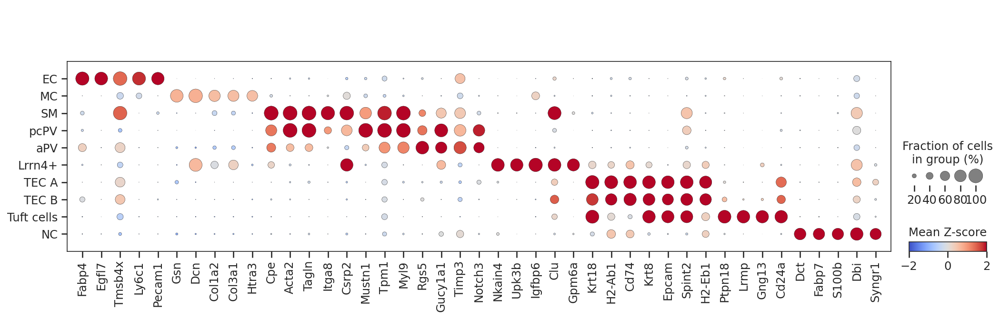

In [54]:
adata_mouse_SC = sc.read_h5ad(f"{PROJECT_DIR}/data/Mouse_SC_conos.h5ad")
adata_mouse_SC.obs.cell_type = adata_mouse_SC.obs.cell_type.cat.reorder_categories(
    ["EC", "MC", "SM", "pcPV", "aPV", "Lrrn4+", "TEC A", "TEC B", "Tuft cells", "NC"]
)

sc.tl.rank_genes_groups(adata_mouse_SC, groupby="cell_type", method="wilcoxon")
adata_mouse_SC.layers["z-score"] = adata_mouse_SC.X.copy()
sc.pp.scale(adata_mouse_SC, layer="z-score")

genes_to_draw = []
n_genes = 5

for group in adata_mouse_SC.obs.cell_type.cat.categories:
    for gene in adata_mouse_SC.uns["rank_genes_groups"]["names"][group][:n_genes]:
        if gene not in genes_to_draw:
            genes_to_draw.append(gene)
            
fig, ax = plt.subplots(figsize=(16.5, 4.5))

sc.pl.dotplot(
    adata_mouse_SC,
    var_names=genes_to_draw,
    groupby="cell_type",
    dendrogram=False,
    swap_axes=False,
    cmap="coolwarm",
    layer="z-score",
    vmin=-2, vmax=2,
    colorbar_title="Mean Z-score",
    ax=ax, show=False
)

plt.savefig(f"{PROJECT_DIR}/figures/FigS2B.pdf", bbox_inches="tight")

del adata_mouse_SC

### SM and NC markers

In [55]:
adata_mouse_SC = sc.read_h5ad(f"{PROJECT_DIR}/data/Mouse_SC_conos.h5ad")
adata_mouse_SC.obs.cell_type = adata_mouse_SC.obs.cell_type.cat.reorder_categories([
    "EC", "MC", "SM", "pcPV", "aPV", "Lrrn4+", "TEC A", "TEC B", "Tuft cells", "NC"
])

adata_mouse_SC.layers["z-score"] = adata_mouse_SC.X.copy()
sc.pp.scale(adata_mouse_SC, layer="z-score")

... as `zero_center=True`, sparse input is densified and may lead to large memory consumption


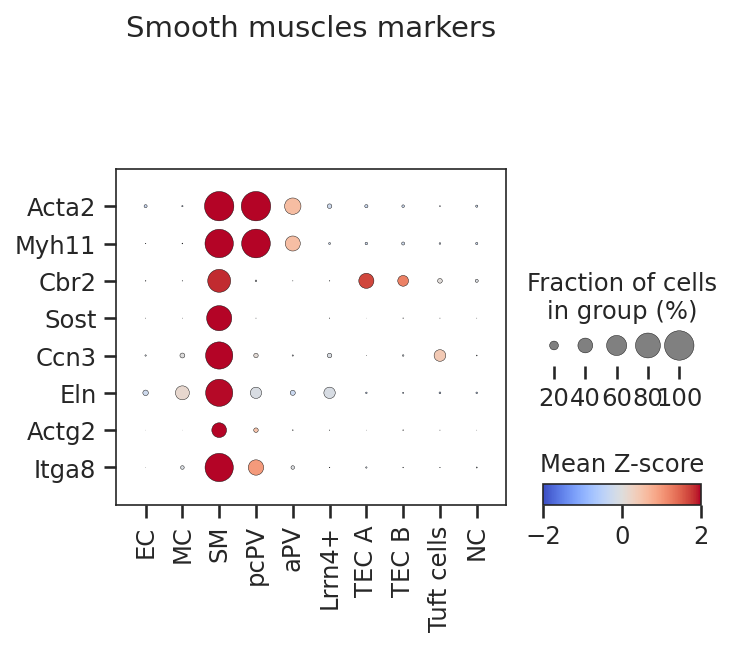

In [56]:
markers = {
    "SM" : ["Acta2", "Myh11", "Cbr2", "Sost", "Ccn3", "Eln", "Actg2", "Itga8"],
    "NC" : ["Dct", "Fabp7", "Mitf", "S100b", "Pax3", "Mlana", "Plp1", "Ptgds"]
}

fig, ax = plt.subplots(figsize=(5, 4), dpi=150)
sc.pl.dotplot(
    adata_mouse_SC,
    var_names=markers["SM"],
    cmap="coolwarm",
    layer="z-score",
    groupby="cell_type",
    vmin=-2, vmax=2,
    colorbar_title="Mean Z-score",
    ax=ax,
    show=False,
    title="Smooth muscles markers",
    swap_axes=True
)

plt.savefig(f"{PROJECT_DIR}/figures/FigS2_SM.pdf", bbox_inches="tight")

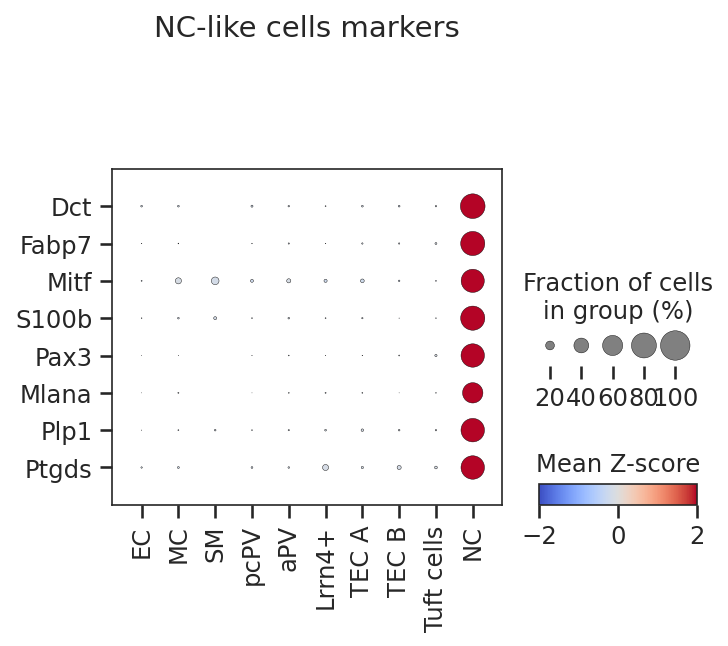

In [59]:
fig, ax = plt.subplots(figsize=(5, 4), dpi=150)
sc.pl.dotplot(
    adata_mouse_SC,
    var_names=markers["NC"],
    cmap="coolwarm",
    layer="z-score",
    groupby="cell_type",
    vmin=-2, vmax=2,
    colorbar_title="Mean Z-score",
    ax=ax,
    show=False,
    title="NC-like cells markers",
    swap_axes=True,
    dot_max=1
)

plt.savefig(f"{PROJECT_DIR}/figures/FigS2_NC.pdf", bbox_inches="tight")

In [60]:
del adata_mouse_SC

## Supplementary Figure 3

### Figure S3A

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:07)
ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:36)
... as `zero_center=True`, sparse input is densified and may lead to large memory consumption
... as `zero_center=True`, sparse input is densified and may lead to large memory consumption


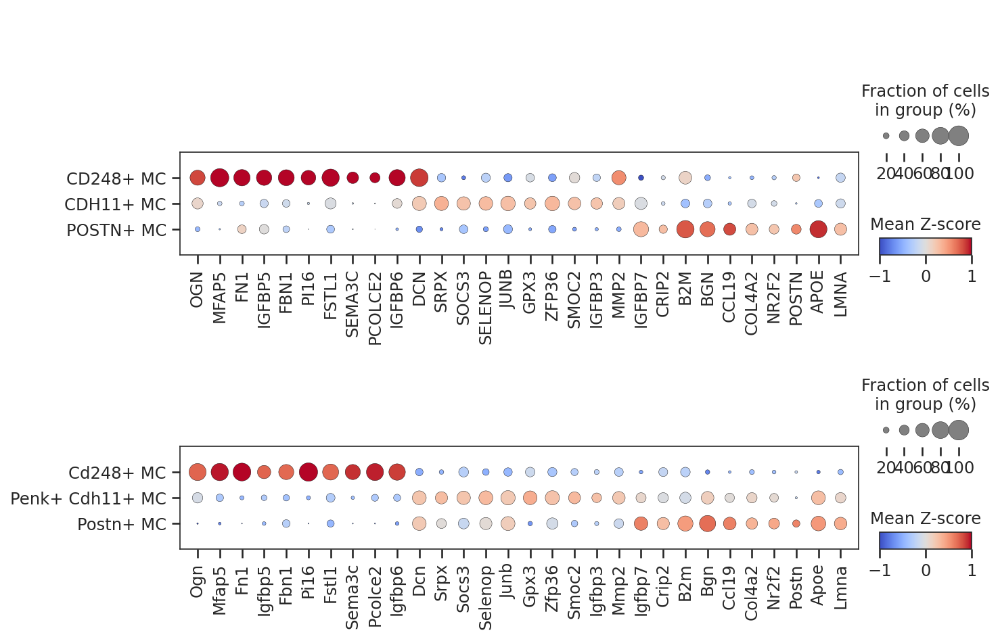

In [62]:
adata_human = sc.read_h5ad(f"{PROJECT_DIR}/data/Human_MC_conos.h5ad")
adata_mouse = sc.read_h5ad(f"{PROJECT_DIR}/data/Mouse_MC_conos.h5ad")

sc.tl.rank_genes_groups(adata_human, groupby="cell_type_l2", method="wilcoxon")
sc.tl.rank_genes_groups(adata_mouse, groupby="cell_type_l2", method="wilcoxon")

adata_human.layers["z-score"] = adata_human.X.copy()
sc.pp.scale(adata_human, layer="z-score")
adata_mouse.layers["z-score"] = adata_mouse.X.copy()
sc.pp.scale(adata_mouse, layer="z-score")

homology = pd.read_csv(f"{PROJECT_DIR}/data/homology/mouse_to_human.tsv", sep="\t")
homology = homology[homology["Human homology type"] == "ortholog_one2one"]
homology = dict(zip(homology["Gene name"], homology["Human gene name"]))
homology_human_mouse = dict(zip(homology.values(), homology.keys()))

n_genes = 10

markes_human = {}
markes_mouse = {}

human_to_mouse = {
    "CD248+ MC" : "Cd248+ MC",
    "CDH11+ MC" : "Penk+ Cdh11+ MC",
    "POSTN+ MC" : "Postn+ MC"
}

for group in human_to_mouse:
    markes_human[group] = []
    markes_mouse[group] = []
    counter = 0
    mouse_genes = []
    human_genes = []
    while len(markes_human[group]) < n_genes:
        if adata_mouse.uns["rank_genes_groups"]["names"][human_to_mouse[group]][counter] in homology:
            mouse_genes.append(homology[adata_mouse.uns["rank_genes_groups"]["names"][human_to_mouse[group]][counter]])
        human_genes.append(adata_human.uns["rank_genes_groups"]["names"][group][counter])
        markes_human[group] = list(set(human_genes) & set(mouse_genes))
        counter += 1
    markes_mouse[group] = [homology_human_mouse[i] for i in markes_human[group]]
    
fig, axes = plt.subplots(nrows=2, figsize=(10, 7))

sc.pl.dotplot(
    adata_human,
    groupby="cell_type_l2",
    var_names=sum(markes_human.values(), []),
    layer="z-score",
    vmin=-1, vmax=1,
    cmap="coolwarm",
    swap_axes=False,
    dendrogram=False,
    ax=axes[0],
    show=False,
    colorbar_title="Mean Z-score",
    dot_max=1
)

sc.pl.dotplot(
    adata_mouse,
    groupby="cell_type_l2",
    var_names=sum(markes_mouse.values(), []),
    layer="z-score",
    vmin=-1, vmax=1,
    cmap="coolwarm",
    swap_axes=False,
    dendrogram=False,
    ax=axes[1],
    show=False,
    colorbar_title="Mean Z-score",
    dot_max=1
)

plt.savefig(f"{PROJECT_DIR}/figures/FigS3A.pdf", bbox_inches="tight")

del adata_human, adata_mouse

### Sigure S3B

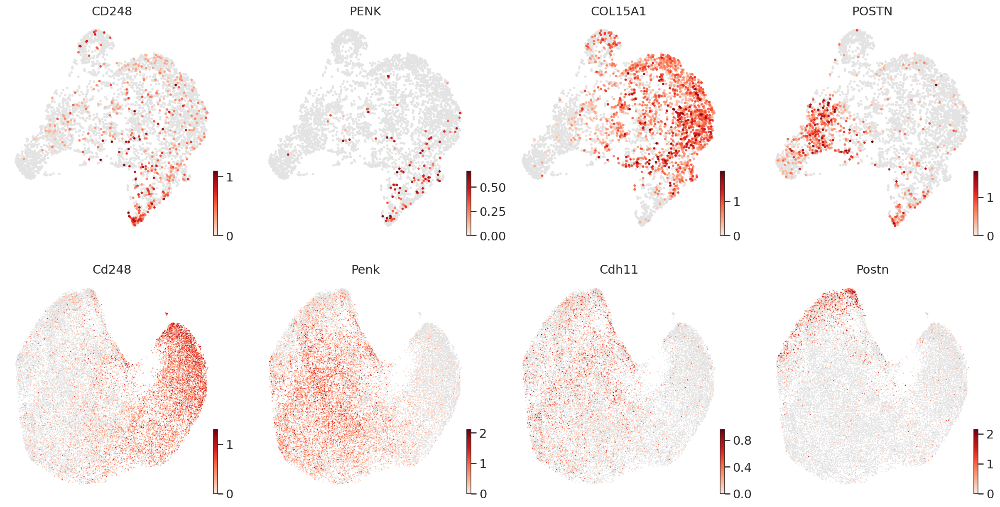

In [64]:
adata_human = sc.read_h5ad(f"{PROJECT_DIR}/data/Human_MC_conos.h5ad")
adata_mouse = sc.read_h5ad(f"{PROJECT_DIR}/data/Mouse_MC_conos.h5ad")

fig, axes = plt.subplots(ncols=4, nrows=2, figsize=(20, 10), dpi=150)

scv.pl.umap(adata_human, color="CD248", ax=axes[0, 0], show=False, cmap=Reds)
scv.pl.umap(adata_human, color="PENK", ax=axes[0, 1], show=False, cmap=Reds)
scv.pl.umap(adata_human, color="COL15A1", ax=axes[0, 2], show=False, cmap=Reds)
scv.pl.umap(adata_human, color="POSTN", ax=axes[0, 3], show=False, cmap=Reds)

scv.pl.umap(adata_mouse, color="Cd248", ax=axes[1, 0], show=False, cmap=Reds)
scv.pl.umap(adata_mouse, color="Penk", ax=axes[1, 1], show=False, cmap=Reds)
scv.pl.umap(adata_mouse, color="Cdh11", ax=axes[1, 2], show=False, cmap=Reds)
scv.pl.umap(adata_mouse, color="Postn", ax=axes[1, 3], show=False, cmap=Reds)

get_cluster_proportions(adata_human, cluster_key="cell_type_l2", sample_key="sample_id").to_csv(f"{PROJECT_DIR}/figures/FigS3B_Human_MCs.tsv", sep="\t")
get_cluster_proportions(adata_mouse, cluster_key="cell_type_l2", sample_key="sample_id").to_csv(f"{PROJECT_DIR}/figures/FigS3B_Mouse_MCs.tsv", sep="\t")

plt.savefig(f"{PROJECT_DIR}/figures/FigS3B.pdf", bbox_inches="tight")

del adata_human, adata_mouse

## Supplementary Figure 4

### Figure S4A

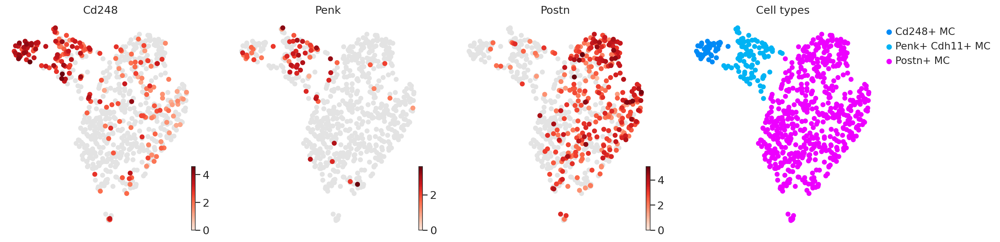

In [65]:
adata_MC = sc.read_h5ad(f"{PROJECT_DIR}/data/Mouse_Bornstein/Mouse_MC.h5ad")

fig, axes = plt.subplots(ncols=4, dpi=150, figsize=(20, 5))

scv.pl.umap(adata_MC, color="Cd248", show=False, ax=axes[0], cmap=Reds)
scv.pl.umap(adata_MC, color="Penk", show=False, ax=axes[1], cmap=Reds)
scv.pl.umap(adata_MC, color="Postn", show=False, ax=axes[2], cmap=Reds)
scv.pl.umap(adata_MC, color="cell_type_Bornstein", show=False, ax=axes[3], title="Cell types")

plt.savefig(f"{PROJECT_DIR}/figures/FigS4A.pdf", bbox_inches="tight")

del adata_MC

### Figure S4B

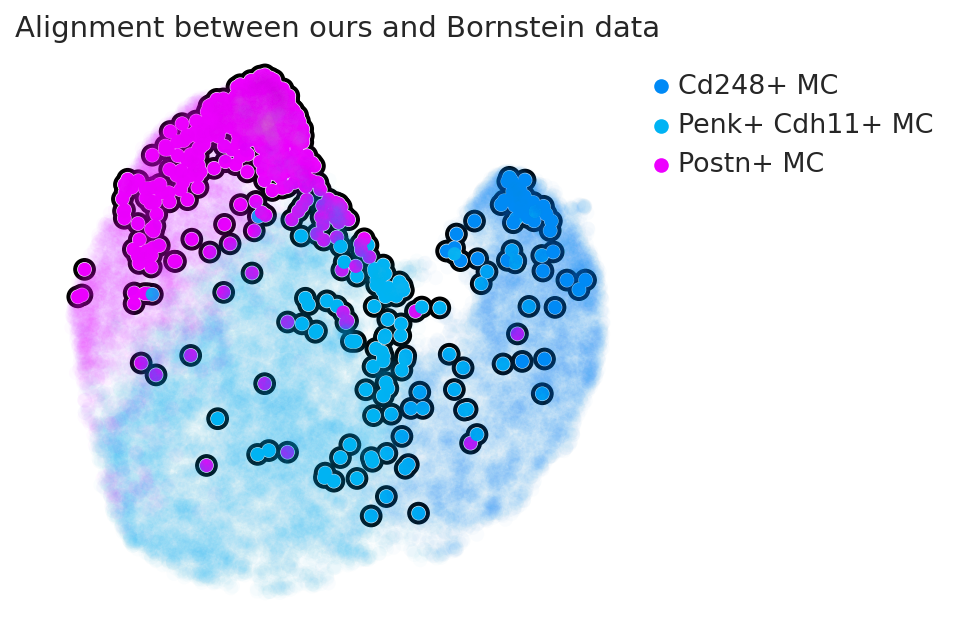

In [66]:
adata_Bornstein = sc.read_h5ad(f"{PROJECT_DIR}/data/Mouse_Bornstein/Mouse_MC_Conos/Mouse_BornsteinOur_integration.h5ad")

fig, ax = plt.subplots(dpi=150, figsize=(5, 5))

sc.pl.umap(adata_Bornstein, color="cell_type_l2", ax=ax, show=False, legend_loc=None, s=200, alpha=0.02)
scv.pl.umap(adata_Bornstein[adata_Bornstein.obs.sample_id == "Bornstein"], color="cell_type_Bornstein", ax=ax,
            show=False, add_outline=True, title="Alignment between ours and Bornstein data")

plt.savefig(f"{PROJECT_DIR}/figures/FigS4B.pdf", bbox_inches="tight")

del adata_Bornstein

### Figure S4C

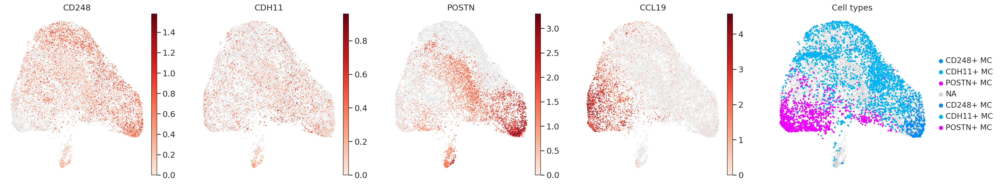

In [69]:
adata_Park = sc.read_h5ad(f"{PROJECT_DIR}/data/Human_Park/MC_conos.h5ad")
adata_Park.uns["cell_type_l2_colors"] = [
    paper_cmap_human[ct] for ct in adata_Park.obs["cell_type_l2"].cat.categories
]
our_samples = ["SCG_HTS1_20190722_F", "SCG_HTS1_20200302_M", "SCG_HTS1_20200309_F"]

fig, axes = plt.subplots(ncols=5, dpi=150, figsize=(28, 5))

sc.pl.umap(adata_Park, color="CD248", show=False, ax=axes[0], cmap=Reds, frameon=False)
sc.pl.umap(adata_Park, color="CDH11", show=False, ax=axes[1], cmap=Reds, frameon=False)
sc.pl.umap(adata_Park, color="POSTN", show=False, ax=axes[2], cmap=Reds, frameon=False)
sc.pl.umap(adata_Park, color="CCL19", show=False, ax=axes[3], cmap=Reds, frameon=False)
sc.pl.umap(adata_Park, show=False, color="cell_type_l2", title="", ax=axes[4], frameon=False)
sc.pl.umap(adata_Park[np.isin(adata_Park.obs.sample_id, our_samples)], color="cell_type_l2", show=False, ax=axes[4], title="Cell types", s=30, frameon=False)

plt.savefig(f"{PROJECT_DIR}/figures/FigS4C.pdf", bbox_inches="tight")

#### Marker genes selection

... as `zero_center=True`, sparse input is densified and may lead to large memory consumption


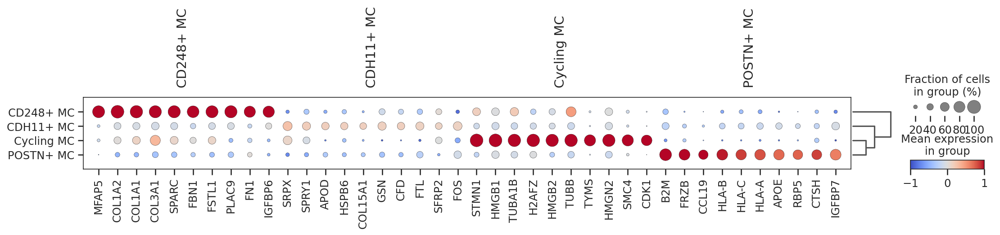

In [70]:
adata_Park.layers["z-score"] = adata_Park.X.copy()
sc.pp.scale(adata_Park, layer="z-score")
sc.pl.rank_genes_groups_dotplot(adata_Park, layer="z-score", cmap="coolwarm", vmin=-1, vmax=1)

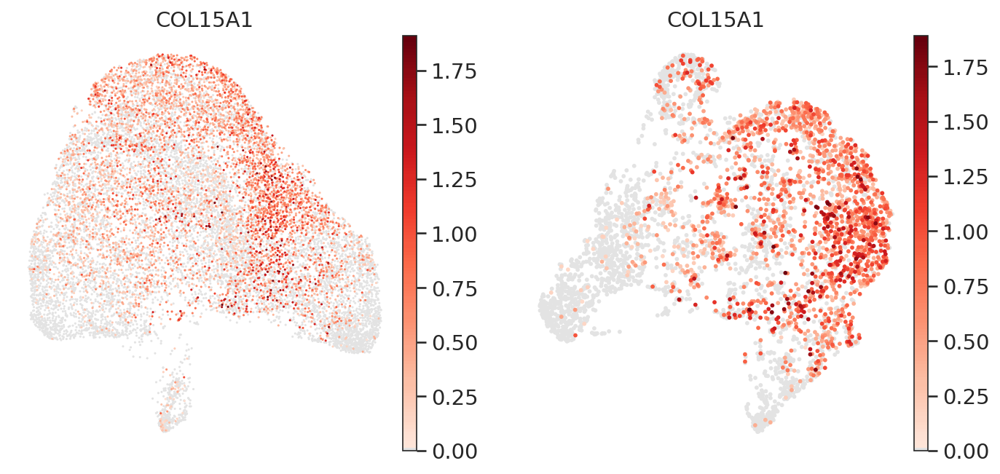

In [73]:
adata_human_MC = sc.read_h5ad(f"{PROJECT_DIR}/data/Human_MC_conos.h5ad")
fig, axes = plt.subplots(dpi=150, figsize=(11, 5), ncols=2)

sc.pl.umap(adata_Park, color=["COL15A1"], frameon=False, cmap=Reds, ax=axes[0], show=False)
sc.pl.umap(adata_human_MC, color=["COL15A1"], frameon=False, cmap=Reds, ax=axes[1], show=False)

plt.savefig(f"{PROJECT_DIR}/figures/FigS4_new_marker.pdf", bbox_inches="tight")

del adata_human_MC, adata_Park

## Supplementary Figure 5

### Figure S5A

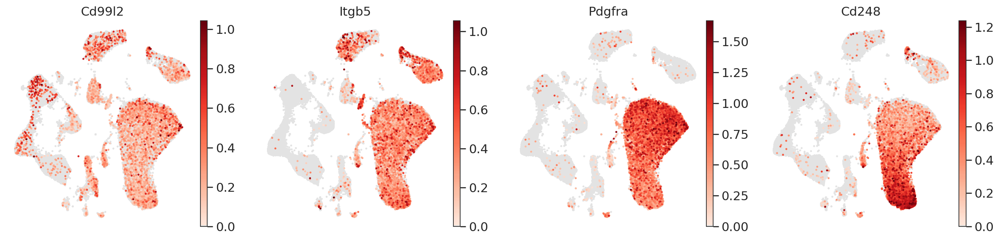

In [74]:
adata_mouse = sc.read_h5ad(f"{PROJECT_DIR}/data/Mouse_AllCells_conos.h5ad")

fig, axes = plt.subplots(dpi=150, ncols=4, figsize=(16, 4))

sc.pl.umap(adata_mouse, color=["Cd99l2"], cmap=Reds, s=20, ax=axes[0], show=False, frameon=False)
sc.pl.umap(adata_mouse, color=["Itgb5"], cmap=Reds, s=20, ax=axes[1], show=False, frameon=False)
sc.pl.umap(adata_mouse, color=["Pdgfra"], cmap=Reds, s=20, ax=axes[2], show=False, frameon=False)
sc.pl.umap(adata_mouse, color=["Cd248"], cmap=Reds, s=20, ax=axes[3], show=False, frameon=False)

fig.tight_layout()
plt.savefig(f"{PROJECT_DIR}/figures/FigS5A.pdf", bbox_inches="tight")

del adata_mouse

## Supplementary figure N

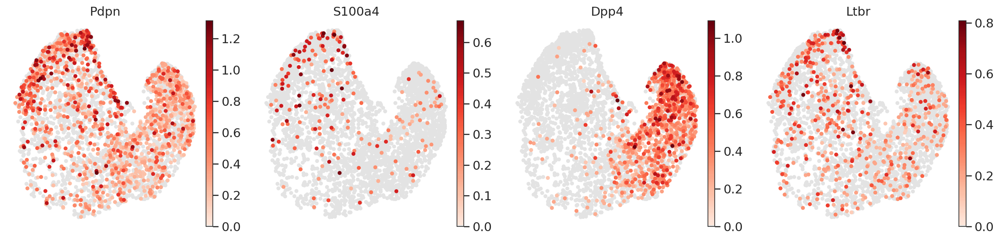

In [77]:
adata_mouse_MC = sc.read_h5ad(f"{PROJECT_DIR}/data/Mouse_MC_conos.h5ad")

fig, axes = plt.subplots(dpi=150, ncols=4, figsize=(16, 4))

sc.pl.umap(adata_mouse_MC[adata_mouse_MC.obs.condition == "control"], color=["Pdpn"], cmap=Reds, s=80, ax=axes[0], show=False, frameon=False)
sc.pl.umap(adata_mouse_MC[adata_mouse_MC.obs.condition == "control"], color=["S100a4"], cmap=Reds, s=80, ax=axes[1], show=False, frameon=False)
sc.pl.umap(adata_mouse_MC[adata_mouse_MC.obs.condition == "control"], color=["Dpp4"], cmap=Reds, s=80, ax=axes[2], show=False, frameon=False)
sc.pl.umap(adata_mouse_MC[adata_mouse_MC.obs.condition == "control"], color=["Ltbr"], cmap=Reds, s=80, ax=axes[3], show=False, frameon=False)

fig.tight_layout()
plt.savefig(f"{PROJECT_DIR}/figures/FigSN_N.pdf", bbox_inches="tight")

del adata_mouse_MC